In [1]:
import pandas as pd
import numpy as np
import os
path = r'D:\learnings\Internship\assignment_questions\capstone\India_Crime -Zip'
os.chdir(path)

In [2]:
dl = pd.read_excel('literacy.xlsx') #Literacy rate of each state

In [3]:
dl['State/UT'] = dl['State/UT'].str.upper()

In [4]:
dl.rename(columns={'State/UT':'STATE/UT'},inplace=True)

In [5]:
len(dl['STATE/UT'].unique())

35

In [6]:
os.listdir()

['01_District_wise_crimes_committed_IPC_2001_2012.csv',
 '02_01_District_wise_crimes_committed_against_SC_2001_2012.csv',
 '02_District_wise_crimes_committed_against_ST_2001_2012.csv',
 '03_District_wise_crimes_committed_against_children_2001_2012.csv',
 '08_01_Juvenile_apprehended_state_IPC_2001_2010.csv',
 '11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv',
 '13_Police_killed_or_injured_on_duty2001_2010.csv',
 '17_Case_reported_and_value_of_property_taken_away_by_place_of_occurrence_2001_2012.csv',
 '17_Crime_by_place_of_occurrence_2001_2012.csv',
 '35_Human_rights_violation_by_police_2001_2010.csv',
 '42_District_wise_crimes_committed_against_women_2001_2012.csv',
 'combined_crimes.xlsx',
 'literacy.xlsx',
 'population_census.xlsx',
 'StatewiseArea.xlsx',
 'total_crimes_all_years.xlsx']

# Data Preperation

In [7]:
files = ['01_District_wise_crimes_committed_IPC_2001_2012.csv',
 '02_01_District_wise_crimes_committed_against_SC_2001_2012.csv',
 '02_District_wise_crimes_committed_against_ST_2001_2012.csv',
 '03_District_wise_crimes_committed_against_children_2001_2012.csv',
 '08_01_Juvenile_apprehended_state_IPC_2001_2010.csv',
 '11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv',
 '17_Crime_by_place_of_occurrence_2001_2012.csv',
 '42_District_wise_crimes_committed_against_women_2001_2012.csv']

We are not considering the files "35_Human_rights_violation_by_police_2001_2010" and "13_Police_killed_or_injured_on_duty2001_2010" since they are not direct crimes and they are events though are connected to crime

In [8]:
dfs = [pd.read_csv(file) for file in files]

In [9]:
def list_cols(dfs):
    for file, df in zip(files,dfs):
        print(file)
        print('=+='*30)
        print(df.columns)
list_cols(dfs)

01_District_wise_crimes_committed_IPC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
Index(['STATE/UT', 'DISTRICT', 'YEAR', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT',
       'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST',
       'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT',
       'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
       'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES',
       'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
       'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES'],
      dtype='object')
02_01_District_wise_cri

In [10]:
dfs[5].rename(columns={'Area_Name':'STATE/UT'},inplace=True)

In [11]:
for file, df in zip(files,dfs):
    print(file)
    print('=+='*30)
    print(len(df['STATE/UT'].unique()))

01_District_wise_crimes_committed_IPC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
02_District_wise_crimes_committed_against_ST_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
03_District_wise_crimes_committed_against_children_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
35
17_Crime_by_place_of_occurrence_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+

In [12]:
print(dfs[-2]['STATE/UT'].unique())

['ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR' 'CHHATTISGARH' 'GOA'
 'GUJARAT' 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND'
 'KARNATAKA' 'KERALA' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR' 'MEGHALAYA'
 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUNJAB' 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU'
 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND' 'WEST BENGAL' 'TOTAL (STATES)'
 'A & N ISLANDS' 'CHANDIGARH' 'D & N HAVELI' 'DAMAN & DIU' 'DELHI'
 'LAKSHADWEEP' 'PUDUCHERRY' 'TOTAL (UTs)' 'TOTAL (ALL-INDIA)']


In [13]:
print(dfs[-1]['STATE/UT'].unique())

['ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR' 'CHHATTISGARH' 'GOA'
 'GUJARAT' 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND'
 'KARNATAKA' 'KERALA' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR' 'MEGHALAYA'
 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUNJAB' 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU'
 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND' 'WEST BENGAL' 'A & N ISLANDS'
 'CHANDIGARH' 'D & N HAVELI' 'DAMAN & DIU' 'DELHI' 'LAKSHADWEEP'
 'PUDUCHERRY']


In [14]:
[x for x in dfs[-2]['STATE/UT'].unique() if x not in dfs[-1]['STATE/UT'].unique()]

['TOTAL (STATES)', 'TOTAL (UTs)', 'TOTAL (ALL-INDIA)']

In [15]:
dfs[-2] = dfs[-2].drop(dfs[-2][dfs[-2]['STATE/UT'].isin(['TOTAL (STATES)', 'TOTAL (UTs)', 'TOTAL (ALL-INDIA)'])].index)

In [16]:
dfs[-2].reset_index(inplace=True, drop=True)

In [17]:
print(dfs[-1]['STATE/UT'].unique())

['ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR' 'CHHATTISGARH' 'GOA'
 'GUJARAT' 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND'
 'KARNATAKA' 'KERALA' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR' 'MEGHALAYA'
 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUNJAB' 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU'
 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND' 'WEST BENGAL' 'A & N ISLANDS'
 'CHANDIGARH' 'D & N HAVELI' 'DAMAN & DIU' 'DELHI' 'LAKSHADWEEP'
 'PUDUCHERRY']


Now we can see that we have removed unwanted rows from "17_Crime_by_place_of_occurrence_2001_2012" so that we can join all the tables if required without any issues

In [18]:
[x for x in dl['STATE/UT'].unique() if x not in dfs[0]['STATE/UT'].unique()]

['A&N ISLANDS',
 'DADRA AND NAGAR HAVELI',
 'DAMAN AND DIU',
 'DELHI',
 'JAMMU AND KASHMIR',
 'MEGHALYA']

In [19]:
[x for x in dfs[0]['STATE/UT'].unique() if x not in dl['STATE/UT'].unique()]

['JAMMU & KASHMIR',
 'MEGHALAYA',
 'A & N ISLANDS',
 'D & N HAVELI',
 'DAMAN & DIU',
 'DELHI UT']

In [20]:
dl['STATE/UT'].unique()

array(['A&N ISLANDS', 'ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM',
       'BIHAR', 'CHANDIGARH', 'CHHATTISGARH', 'DADRA AND NAGAR HAVELI',
       'DAMAN AND DIU', 'DELHI', 'GOA', 'GUJARAT', 'HARYANA',
       'HIMACHAL PRADESH', 'JAMMU AND KASHMIR', 'JHARKHAND', 'KARNATAKA',
       'KERALA', 'LAKSHADWEEP', 'MADHYA PRADESH', 'MAHARASHTRA',
       'MANIPUR', 'MEGHALYA', 'MIZORAM', 'NAGALAND', 'ODISHA',
       'PUDUCHERRY', 'PUNJAB', 'RAJASTHAN', 'SIKKIM', 'TAMIL NADU',
       'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND', 'WEST BENGAL'],
      dtype=object)

In [21]:
dfs[0]['STATE/UT'].unique()

array(['ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM', 'BIHAR',
       'CHHATTISGARH', 'GOA', 'GUJARAT', 'HARYANA', 'HIMACHAL PRADESH',
       'JAMMU & KASHMIR', 'JHARKHAND', 'KARNATAKA', 'KERALA',
       'MADHYA PRADESH', 'MAHARASHTRA', 'MANIPUR', 'MEGHALAYA', 'MIZORAM',
       'NAGALAND', 'ODISHA', 'PUNJAB', 'RAJASTHAN', 'SIKKIM',
       'TAMIL NADU', 'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND',
       'WEST BENGAL', 'A & N ISLANDS', 'CHANDIGARH', 'D & N HAVELI',
       'DAMAN & DIU', 'DELHI UT', 'LAKSHADWEEP', 'PUDUCHERRY'],
      dtype=object)

In [22]:
states = list(dfs[0]['STATE/UT'].unique())

In [23]:
states

['ANDHRA PRADESH',
 'ARUNACHAL PRADESH',
 'ASSAM',
 'BIHAR',
 'CHHATTISGARH',
 'GOA',
 'GUJARAT',
 'HARYANA',
 'HIMACHAL PRADESH',
 'JAMMU & KASHMIR',
 'JHARKHAND',
 'KARNATAKA',
 'KERALA',
 'MADHYA PRADESH',
 'MAHARASHTRA',
 'MANIPUR',
 'MEGHALAYA',
 'MIZORAM',
 'NAGALAND',
 'ODISHA',
 'PUNJAB',
 'RAJASTHAN',
 'SIKKIM',
 'TAMIL NADU',
 'TRIPURA',
 'UTTAR PRADESH',
 'UTTARAKHAND',
 'WEST BENGAL',
 'A & N ISLANDS',
 'CHANDIGARH',
 'D & N HAVELI',
 'DAMAN & DIU',
 'DELHI UT',
 'LAKSHADWEEP',
 'PUDUCHERRY']

In [24]:
for file, df in zip(files,dfs):
    print(file)
    print('=+='*30)
    print([x for x in df['STATE/UT'].unique() if x not in states])

01_District_wise_crimes_committed_IPC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
02_District_wise_crimes_committed_against_ST_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
03_District_wise_crimes_committed_against_children_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['Andhra Pradesh', 'Arunachal Pradesh', 'Assam', 'Bihar', 'Chhattisgarh', 'Goa', 'Gujarat', 'Haryana', 'Himachal Pradesh', 'Jammu & Kashmir', 'Jharkhand', 'Karnataka', 'Kerala', 'Madhya Pradesh', 'Maharashtra', 'Manipur', '

In [25]:
for num, file in enumerate(files):
    dfs[num]['STATE/UT'] = dfs[num]['STATE/UT'].str.upper()
    print(file)

01_District_wise_crimes_committed_IPC_2001_2012.csv
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
02_District_wise_crimes_committed_against_ST_2001_2012.csv
03_District_wise_crimes_committed_against_children_2001_2012.csv
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv
17_Crime_by_place_of_occurrence_2001_2012.csv
42_District_wise_crimes_committed_against_women_2001_2012.csv


In [26]:
for num,(file, df) in enumerate(zip(files,dfs)):
    print(file)
    print(num)
    print('=+='*30)
    print([x for x in df['STATE/UT'].unique() if x not in states])

01_District_wise_crimes_committed_IPC_2001_2012.csv
0
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
1
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
02_District_wise_crimes_committed_against_ST_2001_2012.csv
2
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
03_District_wise_crimes_committed_against_children_2001_2012.csv
3
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['DELHI']
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
4
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['A&N ISLANDS', 'D&N HAVELI']
11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv
5
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
['ANDAMAN & NICOBAR ISLA

In [27]:
for i in [0,4]:
    dfs[i]['STATE/UT'].replace({'DELHI UT':'DELHI'},inplace=True)
    

In [28]:
for i in [0,4]:
    print(dfs[i]['STATE/UT'].unique())

['ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR' 'CHHATTISGARH' 'GOA'
 'GUJARAT' 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND'
 'KARNATAKA' 'KERALA' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR' 'MEGHALAYA'
 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUNJAB' 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU'
 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND' 'WEST BENGAL' 'A & N ISLANDS'
 'CHANDIGARH' 'D & N HAVELI' 'DAMAN & DIU' 'DELHI' 'LAKSHADWEEP'
 'PUDUCHERRY']
['ANDHRA PRADESH' 'ARUNACHAL PRADESH' 'ASSAM' 'BIHAR' 'CHHATTISGARH' 'GOA'
 'GUJARAT' 'HARYANA' 'HIMACHAL PRADESH' 'JAMMU & KASHMIR' 'JHARKHAND'
 'KARNATAKA' 'KERALA' 'MADHYA PRADESH' 'MAHARASHTRA' 'MANIPUR' 'MEGHALAYA'
 'MIZORAM' 'NAGALAND' 'ODISHA' 'PUNJAB' 'RAJASTHAN' 'SIKKIM' 'TAMIL NADU'
 'TRIPURA' 'UTTAR PRADESH' 'UTTARAKHAND' 'WEST BENGAL' 'A&N ISLANDS'
 'CHANDIGARH' 'D&N HAVELI' 'DAMAN & DIU' 'DELHI' 'LAKSHADWEEP'
 'PUDUCHERRY']


In [29]:
dfs[4]['STATE/UT'].replace({'D&N HAVELI':'D & N HAVELI','A&N ISLANDS':'A & N ISLANDS'},inplace=True)

In [30]:
dfs[5]['STATE/UT'].replace({'ANDAMAN & NICOBAR ISLANDS':'A & N ISLANDS','DADRA & NAGAR HAVELI':'D & N HAVELI'},inplace=True)

In [31]:
states = list(dfs[0]['STATE/UT'].unique())

In [32]:
states

['ANDHRA PRADESH',
 'ARUNACHAL PRADESH',
 'ASSAM',
 'BIHAR',
 'CHHATTISGARH',
 'GOA',
 'GUJARAT',
 'HARYANA',
 'HIMACHAL PRADESH',
 'JAMMU & KASHMIR',
 'JHARKHAND',
 'KARNATAKA',
 'KERALA',
 'MADHYA PRADESH',
 'MAHARASHTRA',
 'MANIPUR',
 'MEGHALAYA',
 'MIZORAM',
 'NAGALAND',
 'ODISHA',
 'PUNJAB',
 'RAJASTHAN',
 'SIKKIM',
 'TAMIL NADU',
 'TRIPURA',
 'UTTAR PRADESH',
 'UTTARAKHAND',
 'WEST BENGAL',
 'A & N ISLANDS',
 'CHANDIGARH',
 'D & N HAVELI',
 'DAMAN & DIU',
 'DELHI',
 'LAKSHADWEEP',
 'PUDUCHERRY']

In [33]:
for num,(file, df) in enumerate(zip(files,dfs)):
    print(file)
    print(num)
    print('=+='*30)
    print([x for x in df['STATE/UT'].unique() if x not in states])

01_District_wise_crimes_committed_IPC_2001_2012.csv
0
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
1
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
02_District_wise_crimes_committed_against_ST_2001_2012.csv
2
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
03_District_wise_crimes_committed_against_children_2001_2012.csv
3
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
4
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv
5
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[]
17_Crime_by_place_of_occurrence_2001_2012.csv
6
=+==+==+==+==+==+==+=

Now we have uniformity over all the state/ut columns. Now let's check year

In [34]:
for i in range(len(dfs)):
    if 'Year' in dfs[i].columns:
       dfs[i].rename(columns={'Year':'YEAR'},inplace=True) 

In [35]:
list_cols(dfs)

01_District_wise_crimes_committed_IPC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
Index(['STATE/UT', 'DISTRICT', 'YEAR', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT',
       'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST',
       'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT',
       'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
       'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES',
       'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
       'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES'],
      dtype='object')
02_01_District_wise_cri

In [36]:
for num,(file, df) in enumerate(zip(files,dfs)):
    print(file)
    print(num)
    print('=+='*30)
    print(df['YEAR'].unique())

01_District_wise_crimes_committed_IPC_2001_2012.csv
0
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012]
02_01_District_wise_crimes_committed_against_SC_2001_2012.csv
1
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012]
02_District_wise_crimes_committed_against_ST_2001_2012.csv
2
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012]
03_District_wise_crimes_committed_against_children_2001_2012.csv
3
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
[2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011 2012]
08_01_Juvenile_apprehended_state_IPC_2001_2010.csv
4
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+

We can see that except for "08_01_Juvenile_apprehended_state_IPC_2001_2010" and "11_Property_stolen_and_recovered_nature_of_property_2001_2010" every file have data from 2001 to 2012. They both are missing data for 2011 and 2012

In [37]:
dfs[0]

,STATE/UT,DISTRICT,YEAR,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,...,ARSON,HURT/GREVIOUS HURT,DOWRY DEATHS,ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY,INSULT TO MODESTY OF WOMEN,CRUELTY BY HUSBAND OR HIS RELATIVES,IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES,CAUSING DEATH BY NEGLIGENCE,OTHER IPC CRIMES,TOTAL IPC CRIMES
0,ANDHRA PRADESH,ADILABAD,2001,101,60,17,50,0,50,46,...,30,1131,16,149,34,175,0,181,1518,4154
1,ANDHRA PRADESH,ANANTAPUR,2001,151,125,1,23,0,23,53,...,69,1543,7,118,24,154,0,270,754,4125
2,ANDHRA PRADESH,CHITTOOR,2001,101,57,2,27,0,27,59,...,38,2088,14,112,83,186,0,404,1262,5818
3,ANDHRA PRADESH,CUDDAPAH,2001,80,53,1,20,0,20,25,...,23,795,17,126,38,57,0,233,1181,3140
4,ANDHRA PRADESH,EAST GODAVARI,2001,82,67,1,23,0,23,49,...,41,1244,12,109,58,247,0,431,2313,6507
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9012,LAKSHADWEEP,LAKSHADWEEP,2012,0,0,0,0,0,0,0,...,3,3,0,1,0,1,0,0,32,60
9013,LAKSHADWEEP,TOTAL,2012,0,0,0,0,0,0,0,...,3,3,0,1,0,1,0,0,32,60
9014,PUDUCHERRY,KARAIKAL,2012,5,6,2,6,0,6,2,...,1,186,0,2,0,1,0,44,392,787
9015,PUDUCHERRY,PUDUCHERRY,2012,24,21,10,7,0,7,17,...,20,632,0,7,2,5,0,219,1668,3494


In [38]:
dfs[0][dfs[0].columns[3:-1]].sum(axis=1)

0       4449
1       4567
2       6627
3       3358
4       7600
        ... 
9012      67
9013      67
9014     876
9015    4095
9016    4971
Length: 9017, dtype: int64

In [39]:
dfs[0].iloc[1]

STATE/UT                                               ANDHRA PRADESH
DISTRICT                                                    ANANTAPUR
YEAR                                                             2001
MURDER                                                            151
ATTEMPT TO MURDER                                                 125
CULPABLE HOMICIDE NOT AMOUNTING TO MURDER                           1
RAPE                                                               23
CUSTODIAL RAPE                                                      0
OTHER RAPE                                                         23
KIDNAPPING & ABDUCTION                                             53
KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS                        30
KIDNAPPING AND ABDUCTION OF OTHERS                                 23
DACOITY                                                             8
PREPARATION AND ASSEMBLY FOR DACOITY                                0
ROBBERY             

LET'S GROUP BY DISTRICT AND SUMUP SO THAT WE CAN ANALYSE STATE WISE

In [40]:
df = dfs[0]

In [41]:
dfg = df.drop(columns=['DISTRICT']).groupby(['STATE/UT','YEAR']).sum()

In [42]:
df[df['STATE/UT']=='ANDHRA PRADESH']

,STATE/UT,DISTRICT,YEAR,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,...,ARSON,HURT/GREVIOUS HURT,DOWRY DEATHS,ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY,INSULT TO MODESTY OF WOMEN,CRUELTY BY HUSBAND OR HIS RELATIVES,IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES,CAUSING DEATH BY NEGLIGENCE,OTHER IPC CRIMES,TOTAL IPC CRIMES
0,ANDHRA PRADESH,ADILABAD,2001,101,60,17,50,0,50,46,...,30,1131,16,149,34,175,0,181,1518,4154
1,ANDHRA PRADESH,ANANTAPUR,2001,151,125,1,23,0,23,53,...,69,1543,7,118,24,154,0,270,754,4125
2,ANDHRA PRADESH,CHITTOOR,2001,101,57,2,27,0,27,59,...,38,2088,14,112,83,186,0,404,1262,5818
3,ANDHRA PRADESH,CUDDAPAH,2001,80,53,1,20,0,20,25,...,23,795,17,126,38,57,0,233,1181,3140
4,ANDHRA PRADESH,EAST GODAVARI,2001,82,67,1,23,0,23,49,...,41,1244,12,109,58,247,0,431,2313,6507
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8235,ANDHRA PRADESH,VIZIANAGARAM,2012,44,36,7,44,0,44,21,...,15,1504,3,96,103,363,0,289,1396,4482
8236,ANDHRA PRADESH,WARANGAL,2012,75,47,10,56,0,56,66,...,25,1482,20,117,34,101,0,306,1327,4722
8237,ANDHRA PRADESH,WARANGAL URBAN,2012,41,17,1,30,0,30,41,...,8,1071,9,71,74,267,0,226,742,3583
8238,ANDHRA PRADESH,WEST GODAVARI,2012,91,91,4,130,0,130,86,...,37,2313,19,296,235,757,0,578,1237,7867


In [43]:
dfg

MURDER  ATTEMPT TO MURDER  \
STATE/UT      YEAR                              
A & N ISLANDS 2001      26                  0   
              2002      34                  6   
              2003      42                  8   
              2004      30                  2   
              2005      28                  6   
...                    ...                ...   
WEST BENGAL   2008    3622               3464   
              2009    4136               4238   
              2010    4796               4222   
              2011    4218               4484   
              2012    4504               5708   

                    CULPABLE HOMICIDE NOT AMOUNTING TO MURDER  RAPE  \
STATE/UT      YEAR                                                    
A & N ISLANDS 2001                                          0     6   
              2002                                          2     4   
              2003                                          2     4   
              2004                                          4    20   
              2005                                          6     8   
...                                                       ...   ...   
WEST BENGAL   2008                                        976  4526   
              2009                                       1862  4672   
              2010                                       1260  4622   
              2011                                        972  4726   
              2012                                       1044  4092   

                    CUSTODIAL RAPE  OTHER RAPE  KIDNAPPING & ABDUCTION  \
STATE/UT      YEAR                                                       
A & N ISLANDS 2001               0           6                       4   
              2002               0           4                       4   
              2003               0           4                       4   
              2004               0          20                       6   
              2005               0           8                       4   
...                            ...         ...                     ...   
WEST BENGAL   2008               0        4526                    4664   
              2009               0        4672                    5500   
              2010               0        4622                    6690   
              2011               0        4726                    8570   
              2012               0        4092                   10234   

                    KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS  \
STATE/UT      YEAR                                                
A & N ISLANDS 2001                                            4   
              2002                                            2   
              2003                                            4   
              2004                                            6   
              2005                                            2   
...                                                         ...   
WEST BENGAL   2008                                         3814   
              2009                                         4374   
              2010                                         5528   
              2011                                         7422   
              2012                                         8336   

                    KIDNAPPING AND ABDUCTION OF OTHERS  DACOITY  ...  ARSON  \
STATE/UT      YEAR                                               ...          
A & N ISLANDS 2001                                   0        0  ...      8   
              2002                                   2        2  ...      4   
              2003                                   0        4  ...     16   
              2004                                   0        0  ...     18   
              2005                                   2        0  ...     12   
...                                                ...      ...  ...  

In [44]:
dfg.reset_index()[dfg.reset_index()['STATE/UT']=='ANDHRA PRADESH']

,STATE/UT,YEAR,MURDER,ATTEMPT TO MURDER,CULPABLE HOMICIDE NOT AMOUNTING TO MURDER,RAPE,CUSTODIAL RAPE,OTHER RAPE,KIDNAPPING & ABDUCTION,KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS,...,ARSON,HURT/GREVIOUS HURT,DOWRY DEATHS,ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY,INSULT TO MODESTY OF WOMEN,CRUELTY BY HUSBAND OR HIS RELATIVES,IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES,CAUSING DEATH BY NEGLIGENCE,OTHER IPC CRIMES,TOTAL IPC CRIMES
12,ANDHRA PRADESH,2001,5204,3110,272,1742,0,1742,2364,1530,...,1744,69894,840,7088,4542,11582,14,14800,68688,260178
13,ANDHRA PRADESH,2002,5050,3288,330,2004,0,2004,2604,1708,...,1982,79678,898,7598,4048,14036,0,17382,72770,287220
14,ANDHRA PRADESH,2003,5334,3356,294,1892,0,1892,2970,1862,...,2098,83090,932,8256,4572,16334,10,17030,78484,313902
15,ANDHRA PRADESH,2004,5158,3816,326,2032,0,2032,3052,2060,...,1830,86670,1024,7634,4620,16776,4,22904,72920,317512
16,ANDHRA PRADESH,2005,5500,3448,222,1870,2,1868,3224,1990,...,1934,84358,886,7190,5016,17392,6,19946,75414,314246
17,ANDHRA PRADESH,2006,5532,3720,246,2098,2,2096,4060,2658,...,2024,95892,1038,9068,4822,18328,0,22978,87444,347818
18,ANDHRA PRADESH,2007,5330,3770,270,2140,0,2140,4194,3128,...,2352,92244,1226,8812,6632,22670,0,25258,87172,350174
19,ANDHRA PRADESH,2008,5380,3884,330,2514,0,2514,3940,2792,...,2042,96334,1112,9460,7102,20612,0,25722,87858,358550
20,ANDHRA PRADESH,2009,4898,3718,268,2376,0,2376,3916,3052,...,2078,88976,1092,10294,7040,22594,0,26876,96174,360882
21,ANDHRA PRADESH,2010,5076,3906,310,2724,0,2724,4106,3062,...,1850,93554,1176,9268,9124,24160,0,28170,82746,362876


Similarly we can do for all the dataframes. We will get combined data state wise

In [45]:
for df in dfs:
    print(len(df))

9017
9018
9018
9015
10500
4550
420
9017


#  2.1	Analysis of Literacy Rate vs Total Crimes.

In [46]:
ndf = []
for i in range(len(dfs)):
    if 'DISTRICT' in dfs[i].columns:
        dfg = dfs[i].drop(columns=['DISTRICT']).groupby(['STATE/UT','YEAR']).sum()
        dfg.reset_index(inplace=True)
        ndf.append(dfg)
    else:
        dfg = dfs[i].groupby(['STATE/UT','YEAR']).sum()
        dfg.reset_index(inplace=True)
        ndf.append(dfg)

In [47]:
for df in ndf:
    print(len(df))

420
420
420
420
350
350
419
420


In [48]:
ndf[0]['TOTAL IPC CRIMES']

0        1316
1        1216
2        1288
3        1496
4        1364
        ...  
415    210838
416    226072
417    259232
418    286394
419    322854
Name: TOTAL IPC CRIMES, Length: 420, dtype: int64

In [49]:
ndf[0].columns

Index(['STATE/UT', 'YEAR', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT',
       'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST',
       'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT',
       'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
       'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES',
       'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
       'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES'],
      dtype='object')

In [50]:
l1 = ndf[0][['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [51]:
ndf[1].columns

Index(['STATE/UT', 'YEAR', 'Murder', 'Rape', 'Kidnapping and Abduction',
       'Dacoity', 'Robbery', 'Arson', 'Hurt',
       'Prevention of atrocities (POA) Act',
       'Protection of Civil Rights (PCR) Act', 'Other Crimes Against SCs'],
      dtype='object')

In [52]:
ndf[1].dtypes

STATE/UT                                object
YEAR                                     int64
Murder                                   int64
Rape                                     int64
Kidnapping and Abduction                 int64
Dacoity                                  int64
Robbery                                  int64
Arson                                    int64
Hurt                                     int64
Prevention of atrocities (POA) Act       int64
Protection of Civil Rights (PCR) Act     int64
Other Crimes Against SCs                 int64
dtype: object

In [53]:
ndf[1]['TOTAL IPC CRIMES'] = ndf[1][ndf[1].columns[2:]].sum(axis=1)

In [54]:
l2 = ndf[1][['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [55]:
ndf[1]

,STATE/UT,YEAR,Murder,Rape,Kidnapping and Abduction,Dacoity,Robbery,Arson,Hurt,Prevention of atrocities (POA) Act,Protection of Civil Rights (PCR) Act,Other Crimes Against SCs,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,0,0,0,0,0,0,0,0,0,0,0
1,A & N ISLANDS,2002,0,0,0,0,0,0,0,0,0,0,0
2,A & N ISLANDS,2003,0,0,0,0,0,0,0,0,0,0,0
3,A & N ISLANDS,2004,0,0,0,0,0,0,0,0,0,0,0
4,A & N ISLANDS,2005,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
415,WEST BENGAL,2008,0,0,0,0,0,0,2,16,0,20,38
416,WEST BENGAL,2009,0,0,2,0,0,0,8,20,0,12,42
417,WEST BENGAL,2010,0,2,0,0,0,2,0,54,0,68,126
418,WEST BENGAL,2011,0,2,0,0,0,0,14,74,0,28,118


In [56]:
l2

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,0
1,A & N ISLANDS,2002,0
2,A & N ISLANDS,2003,0
3,A & N ISLANDS,2004,0
4,A & N ISLANDS,2005,0
...,...,...,...
415,WEST BENGAL,2008,38
416,WEST BENGAL,2009,42
417,WEST BENGAL,2010,126
418,WEST BENGAL,2011,118


In [57]:
ndf[2]['TOTAL IPC CRIMES'] = ndf[2][ndf[2].columns[2:]].sum(axis=1)

In [58]:
l3 = ndf[2][['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [59]:
l3

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,2
1,A & N ISLANDS,2002,2
2,A & N ISLANDS,2003,2
3,A & N ISLANDS,2004,2
4,A & N ISLANDS,2005,4
...,...,...,...
415,WEST BENGAL,2008,34
416,WEST BENGAL,2009,32
417,WEST BENGAL,2010,94
418,WEST BENGAL,2011,82


In [60]:
ndf[3]['TOTAL IPC CRIMES'] = ndf[3][ndf[3].columns[2:]].sum(axis=1)

In [61]:
l4 = ndf[3][['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [62]:
l4

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,0.0
1,A & N ISLANDS,2002,0.0
2,A & N ISLANDS,2003,24.0
3,A & N ISLANDS,2004,56.0
4,A & N ISLANDS,2005,32.0
...,...,...,...
415,WEST BENGAL,2008,2052.0
416,WEST BENGAL,2009,1936.0
417,WEST BENGAL,2010,3520.0
418,WEST BENGAL,2011,5800.0


In [63]:
l5 = ndf[4].rename(columns={'Grand total':'TOTAL IPC CRIMES'})[['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [64]:
l5

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,32
1,A & N ISLANDS,2002,13
2,A & N ISLANDS,2003,18
3,A & N ISLANDS,2004,27
4,A & N ISLANDS,2005,24
...,...,...,...
345,WEST BENGAL,2006,288
346,WEST BENGAL,2007,258
347,WEST BENGAL,2008,1447
348,WEST BENGAL,2009,401


In [65]:
l6 = ndf[5].rename(columns={'Cases_Property_Stolen':'TOTAL IPC CRIMES'})[['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [66]:
l6

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,290
1,A & N ISLANDS,2002,222
2,A & N ISLANDS,2003,263
3,A & N ISLANDS,2004,360
4,A & N ISLANDS,2005,351
...,...,...,...
345,WEST BENGAL,2006,34567
346,WEST BENGAL,2007,37290
347,WEST BENGAL,2008,46594
348,WEST BENGAL,2009,47374


In [67]:
ndf[6].columns

Index(['STATE/UT', 'YEAR', 'RESIDENTIAL PREMISES - Dacoity',
       'RESIDENTIAL PREMISES - Robbery', 'RESIDENTIAL PREMISES - Burglary',
       'RESIDENTIAL PREMISES - Theft', 'HIGHWAYS - Dacoity',
       'HIGHWAYS - Robbery', 'HIGHWAYS - Burglary', 'HIGHWAYS - Theft',
       'RIVER and SEA - Dacoity', 'RIVER and SEA - Robbery',
       'RIVER and SEA - Burglary', 'RIVER and SEA - Theft',
       'RAILWAYS - Dacoity', 'RAILWAYS - Robbery', 'RAILWAYS - Burglary',
       'RAILWAYS - Theft', 'BANKS - Dacoity', 'BANKS - Robbery',
       'BANKS - Burglary', 'BANKS - Theft',
       'COMMERCIAL ESTABLISHMENTS - Dacoity',
       'COMMERCIAL ESTABLISHMENTS - Robbery',
       'COMMERCIAL ESTABLISHMENTS - Burglary',
       'COMMERCIAL ESTABLISHMENTS - Theft', 'OTHER PLACES - Dacoity',
       'OTHER PLACES - Robbery', 'OTHER PLACES - Burglary',
       'OTHER PLACES - Theft', 'TOTAL - Dacoity', 'TOTAL - Robbery',
       'TOTAL - Burglary', 'TOTAL - Theft'],
      dtype='object')

In [68]:
ndf[6]['TOTAL IPC CRIMES'] = ndf[6][['TOTAL - Dacoity', 'TOTAL - Robbery',
       'TOTAL - Burglary', 'TOTAL - Theft']].sum(axis=1)

In [71]:
l7 = ndf[6]

In [72]:
l7

,STATE/UT,YEAR,RESIDENTIAL PREMISES - Dacoity,RESIDENTIAL PREMISES - Robbery,RESIDENTIAL PREMISES - Burglary,RESIDENTIAL PREMISES - Theft,HIGHWAYS - Dacoity,HIGHWAYS - Robbery,HIGHWAYS - Burglary,HIGHWAYS - Theft,...,COMMERCIAL ESTABLISHMENTS - Theft,OTHER PLACES - Dacoity,OTHER PLACES - Robbery,OTHER PLACES - Burglary,OTHER PLACES - Theft,TOTAL - Dacoity,TOTAL - Robbery,TOTAL - Burglary,TOTAL - Theft,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,0,0,47,18,0,0,0,0,...,6,0,4,10,40,0,4,64,65,133
1,A & N ISLANDS,2002,0,0,44,16,0,0,0,0,...,0,1,7,0,30,1,7,49,49,106
2,A & N ISLANDS,2003,0,0,36,14,0,0,0,0,...,2,2,7,10,41,2,7,56,60,125
3,A & N ISLANDS,2004,0,1,47,20,0,0,0,0,...,9,0,1,5,68,0,3,69,103,175
4,A & N ISLANDS,2005,0,1,68,20,0,0,0,0,...,31,0,3,0,41,0,4,68,92,164
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
414,WEST BENGAL,2008,62,80,256,3924,17,71,2,67,...,1745,82,393,168,10917,184,613,462,17334,18593
415,WEST BENGAL,2009,70,104,183,5201,24,81,1,108,...,1611,86,507,100,9583,214,751,329,17133,18427
416,WEST BENGAL,2010,110,90,253,6214,34,171,2,114,...,1649,108,466,101,10351,288,798,388,19389,20863
417,WEST BENGAL,2011,72,112,238,5147,20,89,0,47,...,2339,96,471,192,12710,236,760,455,21446,22897


In [73]:
ndf[7]

,STATE/UT,YEAR,Rape,Kidnapping and Abduction,Dowry Deaths,Assault on women with intent to outrage her modesty,Insult to modesty of Women,Cruelty by Husband or his Relatives,Importation of Girls
0,A & N ISLANDS,2001,6,4,0,38,2,18,0
1,A & N ISLANDS,2002,4,2,0,34,6,8,0
2,A & N ISLANDS,2003,4,4,0,18,4,14,0
3,A & N ISLANDS,2004,20,6,0,12,6,10,0
4,A & N ISLANDS,2005,8,2,0,22,2,10,0
...,...,...,...,...,...,...,...,...,...
415,WEST BENGAL,2008,4526,3814,902,4792,188,27326,10
416,WEST BENGAL,2009,4672,4374,1012,3884,216,32224,10
417,WEST BENGAL,2010,4622,5528,1014,4930,326,35592,16
418,WEST BENGAL,2011,4726,7422,1020,4726,400,39544,0


In [74]:
ndf[7].columns

Index(['STATE/UT', 'YEAR', 'Rape', 'Kidnapping and Abduction', 'Dowry Deaths',
       'Assault on women with intent to outrage her modesty',
       'Insult to modesty of Women', 'Cruelty by Husband or his Relatives',
       'Importation of Girls'],
      dtype='object')

In [75]:
ndf[7]['TOTAL IPC CRIMES'] = ndf[7][ndf[7].columns[2:]].sum(axis=1)

In [76]:
l8 = ndf[7][['STATE/UT', 'YEAR','TOTAL IPC CRIMES']]

In [77]:
l8

,STATE/UT,YEAR,TOTAL IPC CRIMES
0,A & N ISLANDS,2001,68
1,A & N ISLANDS,2002,54
2,A & N ISLANDS,2003,44
3,A & N ISLANDS,2004,54
4,A & N ISLANDS,2005,44
...,...,...,...
415,WEST BENGAL,2008,41558
416,WEST BENGAL,2009,46392
417,WEST BENGAL,2010,52028
418,WEST BENGAL,2011,57838


### Now we have made all the dataframes with similar outputs. We've brought everything to same format and structure.

In [78]:
bigdf = pd.DataFrame()   

In [79]:
for df in [eval(f'l{i}') for i in range(1,9)]:
    print(df.dtypes)

STATE/UT            object
YEAR                 int64
TOTAL IPC CRIMES     int64
dtype: object
STATE/UT            object
YEAR                 int64
TOTAL IPC CRIMES     int64
dtype: object
STATE/UT            object
YEAR                 int64
TOTAL IPC CRIMES     int64
dtype: object
STATE/UT             object
YEAR                  int64
TOTAL IPC CRIMES    float64
dtype: object
STATE/UT            object
YEAR                 int64
TOTAL IPC CRIMES     int64
dtype: object
STATE/UT            object
YEAR                 int64
TOTAL IPC CRIMES     int64
dtype: object
STATE/UT                                object
YEAR                                     int64
RESIDENTIAL PREMISES - Dacoity           int64
RESIDENTIAL PREMISES - Robbery           int64
RESIDENTIAL PREMISES - Burglary          int64
RESIDENTIAL PREMISES - Theft             int64
HIGHWAYS - Dacoity                       int64
HIGHWAYS - Robbery                       int64
HIGHWAYS - Burglary                      int64
HIGH

Let's sumup all the crimes happened in the era of analysis from every state

In [80]:
from functools import reduce

In [81]:
ldfs = [eval(f'l{i}') for i in range(1,9)]

In [82]:
for i in range(len(ldfs)):
    ldfs[i].rename(columns={'TOTAL IPC CRIMES':f'TOTAL IPC CRIMES {i}'},inplace=True)

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\2494208222.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ldfs[i].rename(columns={'TOTAL IPC CRIMES':f'TOTAL IPC CRIMES {i}'},inplace=True)


In [83]:
ldfs

[          STATE/UT  YEAR  TOTAL IPC CRIMES 0
 0    A & N ISLANDS  2001                1316
 1    A & N ISLANDS  2002                1216
 2    A & N ISLANDS  2003                1288
 3    A & N ISLANDS  2004                1496
 4    A & N ISLANDS  2005                1364
 ..             ...   ...                 ...
 415    WEST BENGAL  2008              210838
 416    WEST BENGAL  2009              226072
 417    WEST BENGAL  2010              259232
 418    WEST BENGAL  2011              286394
 419    WEST BENGAL  2012              322854
 
 [420 rows x 3 columns],
           STATE/UT  YEAR  TOTAL IPC CRIMES 1
 0    A & N ISLANDS  2001                   0
 1    A & N ISLANDS  2002                   0
 2    A & N ISLANDS  2003                   0
 3    A & N ISLANDS  2004                   0
 4    A & N ISLANDS  2005                   0
 ..             ...   ...                 ...
 415    WEST BENGAL  2008                  38
 416    WEST BENGAL  2009                  42
 417   

In [84]:
df_final_lj = reduce(lambda left, right: pd.merge(left, right, on=['STATE/UT','YEAR'], how='left'), ldfs)

In [85]:
df_final_lj

,STATE/UT,YEAR,TOTAL IPC CRIMES 0,TOTAL IPC CRIMES 1,TOTAL IPC CRIMES 2,TOTAL IPC CRIMES 3,TOTAL IPC CRIMES 4,TOTAL IPC CRIMES 5,RESIDENTIAL PREMISES - Dacoity,RESIDENTIAL PREMISES - Robbery,...,OTHER PLACES - Dacoity,OTHER PLACES - Robbery,OTHER PLACES - Burglary,OTHER PLACES - Theft,TOTAL - Dacoity,TOTAL - Robbery,TOTAL - Burglary,TOTAL - Theft,TOTAL IPC CRIMES 6,TOTAL IPC CRIMES 7
0,A & N ISLANDS,2001,1316,0,2,0.0,32.0,290.0,0.0,0.0,...,0.0,4.0,10.0,40.0,0.0,4.0,64.0,65.0,133.0,68
1,A & N ISLANDS,2002,1216,0,2,0.0,13.0,222.0,0.0,0.0,...,1.0,7.0,0.0,30.0,1.0,7.0,49.0,49.0,106.0,54
2,A & N ISLANDS,2003,1288,0,2,24.0,18.0,263.0,0.0,0.0,...,2.0,7.0,10.0,41.0,2.0,7.0,56.0,60.0,125.0,44
3,A & N ISLANDS,2004,1496,0,2,56.0,27.0,360.0,0.0,1.0,...,0.0,1.0,5.0,68.0,0.0,3.0,69.0,103.0,175.0,54
4,A & N ISLANDS,2005,1364,0,4,32.0,24.0,351.0,0.0,1.0,...,0.0,3.0,0.0,41.0,0.0,4.0,68.0,92.0,164.0,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
415,WEST BENGAL,2008,210838,38,34,2052.0,1447.0,46594.0,62.0,80.0,...,82.0,393.0,168.0,10917.0,184.0,613.0,462.0,17334.0,18593.0,41558
416,WEST BENGAL,2009,226072,42,32,1936.0,401.0,47374.0,70.0,104.0,...,86.0,507.0,100.0,9583.0,214.0,751.0,329.0,17133.0,18427.0,46392
417,WEST BENGAL,2010,259232,126,94,3520.0,696.0,52269.0,110.0,90.0,...,108.0,466.0,101.0,10351.0,288.0,798.0,388.0,19389.0,20863.0,52028
418,WEST BENGAL,2011,286394,118,82,5800.0,NaN,NaN,72.0,112.0,...,96.0,471.0,192.0,12710.0,236.0,760.0,455.0,21446.0,22897.0,57838


In [86]:
df_final_rj = reduce(lambda left, right: pd.merge(left, right, on=['STATE/UT','YEAR'], how='right'), ldfs)

In [87]:
df_final_rj

,STATE/UT,YEAR,TOTAL IPC CRIMES 0,TOTAL IPC CRIMES 1,TOTAL IPC CRIMES 2,TOTAL IPC CRIMES 3,TOTAL IPC CRIMES 4,TOTAL IPC CRIMES 5,RESIDENTIAL PREMISES - Dacoity,RESIDENTIAL PREMISES - Robbery,...,OTHER PLACES - Dacoity,OTHER PLACES - Robbery,OTHER PLACES - Burglary,OTHER PLACES - Theft,TOTAL - Dacoity,TOTAL - Robbery,TOTAL - Burglary,TOTAL - Theft,TOTAL IPC CRIMES 6,TOTAL IPC CRIMES 7
0,A & N ISLANDS,2001,1316.0,0.0,2.0,0.0,32.0,290.0,0.0,0.0,...,0.0,4.0,10.0,40.0,0.0,4.0,64.0,65.0,133.0,68
1,A & N ISLANDS,2002,1216.0,0.0,2.0,0.0,13.0,222.0,0.0,0.0,...,1.0,7.0,0.0,30.0,1.0,7.0,49.0,49.0,106.0,54
2,A & N ISLANDS,2003,1288.0,0.0,2.0,24.0,18.0,263.0,0.0,0.0,...,2.0,7.0,10.0,41.0,2.0,7.0,56.0,60.0,125.0,44
3,A & N ISLANDS,2004,1496.0,0.0,2.0,56.0,27.0,360.0,0.0,1.0,...,0.0,1.0,5.0,68.0,0.0,3.0,69.0,103.0,175.0,54
4,A & N ISLANDS,2005,1364.0,0.0,4.0,32.0,24.0,351.0,0.0,1.0,...,0.0,3.0,0.0,41.0,0.0,4.0,68.0,92.0,164.0,44
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
415,WEST BENGAL,2008,210838.0,38.0,34.0,2052.0,1447.0,46594.0,62.0,80.0,...,82.0,393.0,168.0,10917.0,184.0,613.0,462.0,17334.0,18593.0,41558
416,WEST BENGAL,2009,226072.0,42.0,32.0,1936.0,401.0,47374.0,70.0,104.0,...,86.0,507.0,100.0,9583.0,214.0,751.0,329.0,17133.0,18427.0,46392
417,WEST BENGAL,2010,259232.0,126.0,94.0,3520.0,696.0,52269.0,110.0,90.0,...,108.0,466.0,101.0,10351.0,288.0,798.0,388.0,19389.0,20863.0,52028
418,WEST BENGAL,2011,NaN,NaN,NaN,NaN,NaN,NaN,72.0,112.0,...,96.0,471.0,192.0,12710.0,236.0,760.0,455.0,21446.0,22897.0,57838


In [135]:
df_final_lj['Total_crimes'] = df_final_lj[df_final_lj.columns[2:]].sum(axis=1)

In [136]:
df_final = df_final_lj[['STATE/UT','YEAR','Total_crimes']]

Since census is done only once in 10 years, we should consider 2001's info as valid till 2011

In [137]:
for col in [x for x in range(2002,2011)]:
    dl[col] = dl[2001]

In [138]:
for i,col in enumerate([x for x in range(2002,2011)]):
    dl[col] = dl[2001] + (dl[2011] - dl[2001])*i+1

In [139]:
len(dl)

35

In [140]:
dl.columns[1:]

Index([2001, 2011, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010], dtype='object')

In [141]:
dl.head()

,STATE/UT,2001,2011,2002,2003,2004,2005,2006,2007,2008,2009,2010
0,A&N ISLANDS,81.30,86.63,82.30,87.63,92.96,98.29,103.62,108.95,114.28,119.61,124.94
1,ANDHRA PRADESH,60.47,67.02,61.47,68.02,74.57,81.12,87.67,94.22,100.77,107.32,113.87
2,ARUNACHAL PRADESH,54.34,65.38,55.34,66.38,77.42,88.46,99.50,110.54,121.58,132.62,143.66
3,ASSAM,63.25,72.19,64.25,73.19,82.13,91.07,100.01,108.95,117.89,126.83,135.77
4,BIHAR,47.00,61.80,48.00,62.80,77.60,92.40,107.20,122.00,136.80,151.60,166.40


In [142]:
df = pd.DataFrame()
ind = 0
for i in dl.index:
    for col in dl.columns[1:]:
        df.loc[ind,'STATE/UT'] = dl.loc[i,'STATE/UT']
        df.loc[ind,'YEAR'] = col
        df.loc[ind,'LITERACY_RATE'] = dl.loc[i,col]
        ind += 1

In [143]:
df['YEAR'] = df['YEAR'].astype('int')

In [144]:
len(df)

385

In [145]:
df_final['STATE/UT'].unique()

array(['A & N ISLANDS', 'ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM',
       'BIHAR', 'CHANDIGARH', 'CHHATTISGARH', 'D & N HAVELI',
       'DAMAN & DIU', 'DELHI', 'GOA', 'GUJARAT', 'HARYANA',
       'HIMACHAL PRADESH', 'JAMMU & KASHMIR', 'JHARKHAND', 'KARNATAKA',
       'KERALA', 'LAKSHADWEEP', 'MADHYA PRADESH', 'MAHARASHTRA',
       'MANIPUR', 'MEGHALAYA', 'MIZORAM', 'NAGALAND', 'ODISHA',
       'PUDUCHERRY', 'PUNJAB', 'RAJASTHAN', 'SIKKIM', 'TAMIL NADU',
       'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND', 'WEST BENGAL'],
      dtype=object)

In [146]:
len(df_final)

420

In [147]:
[x for x in df['STATE/UT'].unique() if x not in df_final['STATE/UT'].unique()]

['A&N ISLANDS',
 'DADRA AND NAGAR HAVELI',
 'DAMAN AND DIU',
 'JAMMU AND KASHMIR',
 'MEGHALYA']

In [148]:
repl = {}
for x,y in zip([x for x in df_final['STATE/UT'].unique() if x not in df['STATE/UT'].unique()],[x for x in df['STATE/UT'].unique() if x not in df_final['STATE/UT'].unique()]):
    repl[x] = y

In [149]:
repl

{'A & N ISLANDS': 'A&N ISLANDS',
 'D & N HAVELI': 'DADRA AND NAGAR HAVELI',
 'DAMAN & DIU': 'DAMAN AND DIU',
 'JAMMU & KASHMIR': 'JAMMU AND KASHMIR',
 'MEGHALAYA': 'MEGHALYA'}

In [150]:
df_final['STATE/UT'].replace(repl,inplace=True)

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\136906819.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_final['STATE/UT'].replace(repl,inplace=True)


In [151]:
[x for x in df['STATE/UT'].unique() if x not in df_final['STATE/UT'].unique()]

[]

In [152]:
[x for x in df_final['STATE/UT'].unique() if x not in df['STATE/UT'].unique()]

[]

In [153]:
df['YEAR'].unique()

array([2001, 2011, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010])

In [154]:
df_final['YEAR'].unique()

array([2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011,
       2012], dtype=int64)

In [155]:
df_final[df_final['YEAR'] != 2012]

,STATE/UT,YEAR,Total_crimes
0,A&N ISLANDS,2001,4214.0
1,A&N ISLANDS,2002,3650.0
2,A&N ISLANDS,2003,4028.0
3,A&N ISLANDS,2004,5040.0
4,A&N ISLANDS,2005,4622.0
...,...,...,...
414,WEST BENGAL,2007,556470.0
415,WEST BENGAL,2008,716680.0
416,WEST BENGAL,2009,755060.0
417,WEST BENGAL,2010,861108.0


now both of them have same number of rows and similar data

In [156]:
final_df = df.set_index(['STATE/UT','YEAR']).join(df_final.set_index(['STATE/UT','YEAR']))

In [157]:
final_df = final_df.reset_index()

In [158]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

In [159]:
final_df

,STATE/UT,YEAR,LITERACY_RATE,Total_crimes
0,A&N ISLANDS,2001,81.30,4214.0
1,A&N ISLANDS,2011,86.63,4774.0
2,A&N ISLANDS,2002,82.30,3650.0
3,A&N ISLANDS,2003,87.63,4028.0
4,A&N ISLANDS,2004,92.96,5040.0
...,...,...,...,...
380,WEST BENGAL,2006,100.12,478630.0
381,WEST BENGAL,2007,107.74,556470.0
382,WEST BENGAL,2008,115.36,716680.0
383,WEST BENGAL,2009,122.98,755060.0


<Axes: xlabel='LITERACY_RATE', ylabel='Total_crimes'>

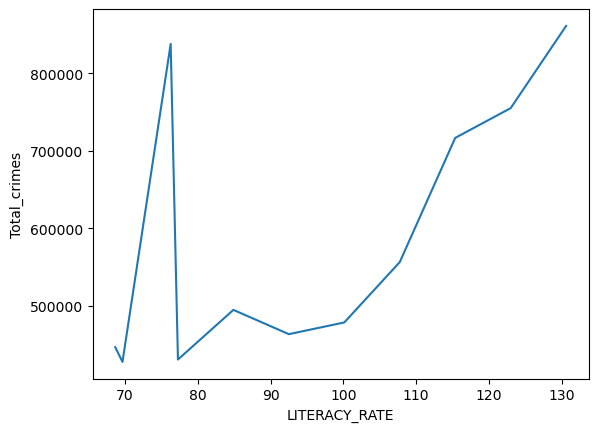

In [160]:
state_df = final_df[final_df['STATE/UT'] == 'WEST BENGAL']
sns.lineplot(data=state_df, x='LITERACY_RATE',y='Total_crimes')

<Axes: xlabel='LITERACY_RATE', ylabel='Total_crimes'>

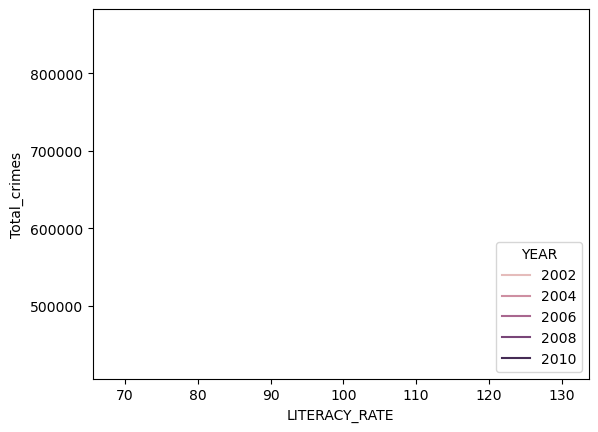

In [161]:
state_df = final_df[final_df['STATE/UT'] == 'WEST BENGAL']
sns.lineplot(data=state_df, x='LITERACY_RATE',y='Total_crimes',hue='YEAR')

<Axes: xlabel='Total_crimes', ylabel='LITERACY_RATE'>

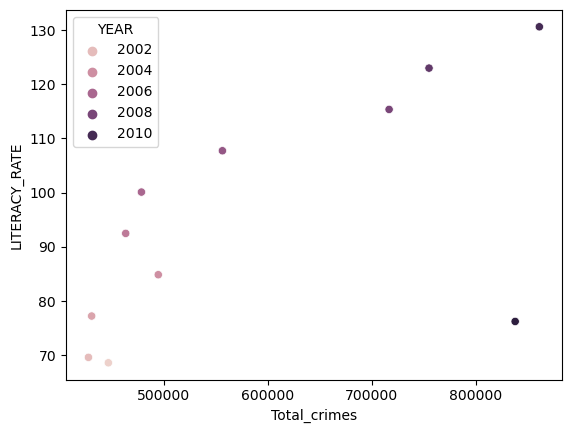

In [162]:
state_df = final_df[final_df['STATE/UT'] == 'WEST BENGAL']
sns.scatterplot(data=state_df, x='Total_crimes',y='LITERACY_RATE',hue='YEAR')

In [163]:
fig,axes = plt.subplots(35,1,figsize=(20,300))
for state,ax in zip(final_df['STATE/UT'].unique(),axes.flat):
    state_df = final_df[final_df['STATE/UT'] == state]
    state_df['YEAR'] = state_df['YEAR'].astype('category')
    ax = sns.lineplot(data=state_df, x='LITERACY_RATE',y='Total_crimes',ax=ax)
    ax.set_title(state)
    
    
plt.tight_layout()
plt.show()

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3609639321.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

In [164]:
fig,axes = plt.subplots(35,1,figsize=(20,300))
for state,ax in zip(final_df['STATE/UT'].unique(),axes.flat[:-1]):
    state_df = final_df[final_df['STATE/UT'] == state]
    ax = sns.scatterplot(data=state_df, x='LITERACY_RATE',y='Total_crimes',ax=ax,hue='YEAR')
    ax.set_title(state)
    
    
plt.tight_layout()
plt.show()

Above graphs show literacy vs increase or decrease on crime rate over all states of india

###            2.3	Analysis of year-on-year total crime rate.

In [165]:
fig,axes = plt.subplots(35,1,figsize=(20,300))
for state,ax in zip(final_df['STATE/UT'].unique(),axes.flat):
    state_df = final_df[final_df['STATE/UT'] == state]
#     state_df['YEAR'] = state_df['YEAR'].astype('category')
    ax = sns.lineplot(data=state_df, x='YEAR',y='Total_crimes',ax=ax)
    ax.set_title(state)
    
    
plt.tight_layout()
plt.show()

Above graphs show year on year increase or decrease on crime rate over all states of india

###   2.5	Analysis of Population vs overall Crime.

In [166]:
da = pd.read_excel('population_census.xlsx')

In [167]:
da = da[~da['Name'].isin(['Telangana','Total'])]

We can delete telangana since it was bifercated in the year 2014.

In [168]:
da

,Name,2001[11],2011[11],UT
0,Uttar Pradesh,166053600.0,199581477,0.0
1,Maharashtra,96752500.0,112372972,0.0
2,Bihar,82879910.0,103804630,0.0
3,West Bengal,80221300.0,91347736,0.0
4,Madhya Pradesh,60385090.0,72597565,0.0
5,Tamil Nadu,62111390.0,72138958,0.0
6,Rajasthan,56473300.0,68621012,0.0
7,Karnataka,52734986.0,61130704,0.0
8,Gujarat,50597200.0,60383628,0.0
9,Andhra Pradesh,75728400.0,49386799,0.0


In [169]:
da = da.rename(columns={'Name':'STATE/UT','2001[11]':2001,'2011[11]':2011}).drop(columns=['UT'])

In [170]:
for i, col in enumerate([x for x in range(2002,2011)]):
    da[col] = da[2001] + (da[2011]-da[2001]/(i+1))

In [171]:
da

,STATE/UT,2001,2011,2002,2003,2004,2005,2006,2007,2008,2009,2010
0,Uttar Pradesh,166053600.0,199581477,199581477.0,282608277.0,3.102839e+08,3.241217e+08,332424357.0,3.379595e+08,3.419131e+08,3.448784e+08,3.471847e+08
1,Maharashtra,96752500.0,112372972,112372972.0,160749222.0,1.768746e+08,1.849373e+08,189774972.0,1.930001e+08,1.953037e+08,1.970314e+08,1.983752e+08
2,Bihar,82879910.0,103804630,103804630.0,145244585.0,1.590579e+08,1.659646e+08,170108558.0,1.728712e+08,1.748446e+08,1.763246e+08,1.774757e+08
3,West Bengal,80221300.0,91347736,91347736.0,131458386.0,1.448286e+08,1.515137e+08,155524776.0,1.581988e+08,1.601089e+08,1.615414e+08,1.626556e+08
4,Madhya Pradesh,60385090.0,72597565,72597565.0,102790110.0,1.128543e+08,1.178864e+08,120905637.0,1.229185e+08,1.243562e+08,1.254345e+08,1.262732e+08
5,Tamil Nadu,62111390.0,72138958,72138958.0,103194653.0,1.135466e+08,1.187225e+08,121828070.0,1.238984e+08,1.253773e+08,1.264864e+08,1.273491e+08
6,Rajasthan,56473300.0,68621012,68621012.0,96857662.0,1.062699e+08,1.109760e+08,113799652.0,1.156821e+08,1.170267e+08,1.180351e+08,1.188195e+08
7,Karnataka,52734986.0,61130704,61130704.0,87498197.0,9.628736e+07,1.006819e+08,103318692.8,1.050765e+08,1.063321e+08,1.072738e+08,1.080062e+08
8,Gujarat,50597200.0,60383628,60383628.0,85682228.0,9.411509e+07,9.833153e+07,100861388.0,1.025480e+08,1.037527e+08,1.046562e+08,1.053589e+08
9,Andhra Pradesh,75728400.0,49386799,49386799.0,87250999.0,9.987240e+07,1.061831e+08,109969519.0,1.124938e+08,1.142969e+08,1.156491e+08,1.167009e+08


In [172]:
dfa = pd.DataFrame()
ind = 0
for i in da.index:
    for col in dl.columns[1:]:
        dfa.loc[ind,'STATE/UT'] = da.loc[i,'STATE/UT']
        dfa.loc[ind,'YEAR'] = col
        dfa.loc[ind,'AREA'] = da.loc[i,col]
        ind += 1

In [173]:
dfa

,STATE/UT,YEAR,AREA
0,Uttar Pradesh,2001.0,1.660536e+08
1,Uttar Pradesh,2011.0,1.995815e+08
2,Uttar Pradesh,2002.0,1.995815e+08
3,Uttar Pradesh,2003.0,2.826083e+08
4,Uttar Pradesh,2004.0,3.102839e+08
...,...,...,...
380,Lakshadweep,2006.0,1.134690e+05
381,Lakshadweep,2007.0,1.155123e+05
382,Lakshadweep,2008.0,1.169719e+05
383,Lakshadweep,2009.0,1.180665e+05


In [174]:
dfa['STATE/UT'] = dfa['STATE/UT'].str.upper().str.strip()

In [175]:
final_df['STATE/UT'].unique()

array(['A&N ISLANDS', 'ANDHRA PRADESH', 'ARUNACHAL PRADESH', 'ASSAM',
       'BIHAR', 'CHANDIGARH', 'CHHATTISGARH', 'DADRA AND NAGAR HAVELI',
       'DAMAN AND DIU', 'DELHI', 'GOA', 'GUJARAT', 'HARYANA',
       'HIMACHAL PRADESH', 'JAMMU AND KASHMIR', 'JHARKHAND', 'KARNATAKA',
       'KERALA', 'LAKSHADWEEP', 'MADHYA PRADESH', 'MAHARASHTRA',
       'MANIPUR', 'MEGHALYA', 'MIZORAM', 'NAGALAND', 'ODISHA',
       'PUDUCHERRY', 'PUNJAB', 'RAJASTHAN', 'SIKKIM', 'TAMIL NADU',
       'TRIPURA', 'UTTAR PRADESH', 'UTTARAKHAND', 'WEST BENGAL'],
      dtype=object)

In [176]:
[x for x in dfa['STATE/UT'].unique() if x not in final_df['STATE/UT'].unique()]

['MEGHALAYA', 'ANDAMAN AND NICOBAR ISLANDS']

In [177]:
[x for x in final_df['STATE/UT'].unique() if x not in dfa['STATE/UT'].unique()]

['A&N ISLANDS', 'MEGHALYA']

In [178]:
dfa.replace({'MEGHALAYA':'MEGHALYA','ANDAMAN AND NICOBAR ISLANDS':'A&N ISLANDS'},inplace=True)

In [179]:
dfa['STATE/UT'].unique()

array(['UTTAR PRADESH', 'MAHARASHTRA', 'BIHAR', 'WEST BENGAL',
       'MADHYA PRADESH', 'TAMIL NADU', 'RAJASTHAN', 'KARNATAKA',
       'GUJARAT', 'ANDHRA PRADESH', 'ODISHA', 'KERALA', 'JHARKHAND',
       'ASSAM', 'PUNJAB', 'HARYANA', 'CHHATTISGARH', 'UTTARAKHAND',
       'HIMACHAL PRADESH', 'TRIPURA', 'MEGHALYA', 'MANIPUR', 'NAGALAND',
       'GOA', 'ARUNACHAL PRADESH', 'MIZORAM', 'SIKKIM',
       'JAMMU AND KASHMIR', 'DELHI', 'PUDUCHERRY', 'CHANDIGARH',
       'A&N ISLANDS', 'DADRA AND NAGAR HAVELI', 'DAMAN AND DIU',
       'LAKSHADWEEP'], dtype=object)

In [180]:
final_dfa = dfa.set_index(['STATE/UT','YEAR']).join(final_df.set_index(['STATE/UT','YEAR']))

In [181]:
final_dfa.reset_index(inplace=True)

In [182]:
final_dfa

,STATE/UT,YEAR,AREA,LITERACY_RATE,Total_crimes
0,UTTAR PRADESH,2001.0,1.660536e+08,56.27,1269074.0
1,UTTAR PRADESH,2011.0,1.995815e+08,67.68,1221210.0
2,UTTAR PRADESH,2002.0,1.995815e+08,57.27,1009794.0
3,UTTAR PRADESH,2003.0,2.826083e+08,68.68,671966.0
4,UTTAR PRADESH,2004.0,3.102839e+08,80.09,923448.0
...,...,...,...,...,...
380,LAKSHADWEEP,2006.0,1.134690e+05,108.42,518.0
381,LAKSHADWEEP,2007.0,1.155123e+05,113.61,488.0
382,LAKSHADWEEP,2008.0,1.169719e+05,118.80,508.0
383,LAKSHADWEEP,2009.0,1.180665e+05,123.99,874.0


In [183]:
final_dfa.AREA.unique()

array([1.66053600e+08, 1.99581477e+08, 2.82608277e+08, 3.10283877e+08,
       3.24121677e+08, 3.32424357e+08, 3.37959477e+08, 3.41913134e+08,
       3.44878377e+08, 3.47184677e+08, 9.67525000e+07, 1.12372972e+08,
       1.60749222e+08, 1.76874639e+08, 1.84937347e+08, 1.89774972e+08,
       1.93000055e+08, 1.95303686e+08, 1.97031410e+08, 1.98375194e+08,
       8.28799100e+07, 1.03804630e+08, 1.45244585e+08, 1.59057903e+08,
       1.65964562e+08, 1.70108558e+08, 1.72871222e+08, 1.74844553e+08,
       1.76324551e+08, 1.77475661e+08, 8.02213000e+07, 9.13477360e+07,
       1.31458386e+08, 1.44828603e+08, 1.51513711e+08, 1.55524776e+08,
       1.58198819e+08, 1.60108850e+08, 1.61541374e+08, 1.62655558e+08,
       6.03850900e+07, 7.25975650e+07, 1.02790110e+08, 1.12854292e+08,
       1.17886382e+08, 1.20905637e+08, 1.22918473e+08, 1.24356214e+08,
       1.25434519e+08, 1.26273201e+08, 6.21113900e+07, 7.21389580e+07,
       1.03194653e+08, 1.13546551e+08, 1.18722500e+08, 1.21828070e+08,
      

In [184]:
final_dfa.isnull().sum()

STATE/UT         0
YEAR             0
AREA             0
LITERACY_RATE    0
Total_crimes     0
dtype: int64

In [185]:
fig,axes = plt.subplots(35,1,figsize=(20,300))
for state,ax in zip(final_dfa['STATE/UT'].unique(),axes.flat):
    print(state)
    state_df = final_dfa[final_dfa['STATE/UT'] == state]
    state_df['YEAR'] = state_df['YEAR'].astype('category')
    ax = sns.lineplot(data=state_df, x='AREA',y='Total_crimes',ax=ax)
    ax.set_title(state)
        
plt.tight_layout()
plt.show()

UTTAR PRADESH
MAHARASHTRA
BIHAR
WEST BENGAL
MADHYA PRADESH


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

TAMIL NADU
RAJASTHAN
KARNATAKA
GUJARAT
ANDHRA PRADESH


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

ODISHA
KERALA
JHARKHAND


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

ASSAM
PUNJAB
HARYANA
CHHATTISGARH
UTTARAKHAND
HIMACHAL PRADESH


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

TRIPURA
MEGHALYA
MANIPUR
NAGALAND
GOA


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

ARUNACHAL PRADESH
MIZORAM
SIKKIM
JAMMU AND KASHMIR
DELHI


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

PUDUCHERRY
CHANDIGARH
A&N ISLANDS
DADRA AND NAGAR HAVELI
DAMAN AND DIU


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')
C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice

LAKSHADWEEP


C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1155791401.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  state_df['YEAR'] = state_df['YEAR'].astype('category')


Above is the population wise analysis of crime rate

## 2.4 State AreaWise Analysis

In [186]:
dfa = pd.read_excel('StatewiseArea.xlsx')

In [187]:
dfa

,Rank,State /,Area (km2),Region,%
0,1 (S1),Rajasthan,342239,Western,10.4110
1,2 (S2),Madhya Pradesh,308252,Central,9.3770
2,3 (S3),Maharashtra,307713,Western,9.3600
3,4 (S4),Uttar Pradesh,240928,Northern,7.3290
4,5 (S5),Gujarat,196024,Western,5.9630
5,6 (S6),Karnataka,191791,Southern,5.8340
6,7 (S7),Andhra Pradesh,162975,Southern,4.9570
7,8 (S8),Odisha,155707,Eastern,4.7361
8,9 (S9),Chhattisgarh,135192,Central,4.1120
9,10 (S10),Tamil Nadu,130058,Southern,3.9560


In [188]:
dfa.columns

Index(['Rank', 'State /', 'Area (km2)', 'Region', '%'], dtype='object')

In [189]:
dfa = dfa.drop(columns=['Rank','Region', '%'])

In [190]:
dfa = dfa.rename(columns = {'State /':'STATE/UT'})

In [191]:
dfa_final = final_df.drop(columns=['YEAR','LITERACY_RATE']).groupby('STATE/UT').sum().reset_index()

In [192]:
dfa['STATE/UT'] = dfa['STATE/UT'].str.upper()

In [193]:
len(dfa)

37

In [194]:
dfa[dfa['STATE/UT'] == 'TELANGANA']

,STATE/UT,Area (km2)
10,TELANGANA,112077


In [195]:
dfa[dfa['STATE/UT'] == 'ANDHRA PRADESH']['Area (km2)']

6    162975
Name: Area (km2), dtype: int64

In [196]:
tot = int(dfa[dfa['STATE/UT'] == 'ANDHRA PRADESH']['Area (km2)']) + int(dfa[dfa['STATE/UT'] == 'TELANGANA']['Area (km2)'])

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\122862530.py:1: FutureWarning: Calling int on a single element Series is deprecated and will raise a TypeError in the future. Use int(ser.iloc[0]) instead
  tot = int(dfa[dfa['STATE/UT'] == 'ANDHRA PRADESH']['Area (km2)']) + int(dfa[dfa['STATE/UT'] == 'TELANGANA']['Area (km2)'])


In [197]:
dfa.loc[dfa[dfa['STATE/UT'] == 'ANDHRA PRADESH'].index,'Area (km2)'] = tot

In [198]:
dfa[dfa['STATE/UT'] == 'ANDHRA PRADESH']['Area (km2)']

6    275052
Name: Area (km2), dtype: int64

In [199]:
dfa = dfa[~dfa['STATE/UT'].isin(['TELANGANA','INDIA','LADAKH'])].reset_index(drop=True)

In [200]:
dfa

,STATE/UT,Area (km2)
0,RAJASTHAN,342239
1,MADHYA PRADESH,308252
2,MAHARASHTRA,307713
3,UTTAR PRADESH,240928
4,GUJARAT,196024
5,KARNATAKA,191791
6,ANDHRA PRADESH,275052
7,ODISHA,155707
8,CHHATTISGARH,135192
9,TAMIL NADU,130058


We have dropped Ladakh and Telangana since they were formed after our review period

In [201]:
[x for x in dfa['STATE/UT'].unique() if x not in dfa_final['STATE/UT'].unique()]

['MEGHALAYA',
 'ANDAMAN AND NICOBAR ISLANDS',
 'NATIONAL CAPITAL TERRITORY–DELHI',
 'DADRA AND NAGAR HAVELI AND DAMAN AND DIU']

In [202]:
dfa[dfa['STATE/UT']=='DADRA AND NAGAR HAVELI AND DAMAN AND DIU']

,STATE/UT,Area (km2)
30,DADRA AND NAGAR HAVELI AND DAMAN AND DIU,603


In [203]:
[x for x in dfa_final['STATE/UT'].unique() if x not in dfa['STATE/UT'].unique()]

['A&N ISLANDS', 'DADRA AND NAGAR HAVELI', 'DAMAN AND DIU', 'DELHI', 'MEGHALYA']

In [204]:
len(dfa)

34

In [205]:
len(dfa_final)

35

In [206]:
i = len(dfa)
dfa.loc[i,'Area (km2)'] = 487
dfa.loc[i,'STATE/UT'] = 'DADRA AND NAGAR HAVELI'


In [207]:
i = len(dfa)
dfa.loc[i,'Area (km2)'] = 112
dfa.loc[i,'STATE/UT'] = 'DAMAN AND DIU'

In [208]:
dfa = dfa[~(dfa['STATE/UT'] == 'DADRA AND NAGAR HAVELI AND DAMAN AND DIU')]

In [209]:
dfa.reset_index(inplace=True, drop=True)

In [210]:
dfa

,STATE/UT,Area (km2)
0,RAJASTHAN,342239.0
1,MADHYA PRADESH,308252.0
2,MAHARASHTRA,307713.0
3,UTTAR PRADESH,240928.0
4,GUJARAT,196024.0
5,KARNATAKA,191791.0
6,ANDHRA PRADESH,275052.0
7,ODISHA,155707.0
8,CHHATTISGARH,135192.0
9,TAMIL NADU,130058.0


In [211]:
len(dfa)

35

In [212]:
[x for x in dfa_final['STATE/UT'].unique() if x not in dfa['STATE/UT'].unique()]

['A&N ISLANDS', 'DELHI', 'MEGHALYA']

In [213]:
[x for x in dfa['STATE/UT'].unique() if x not in dfa_final['STATE/UT'].unique()]

['MEGHALAYA',
 'ANDAMAN AND NICOBAR ISLANDS',
 'NATIONAL CAPITAL TERRITORY–DELHI']

In [214]:
dfa.replace({'NATIONAL CAPITAL TERRITORY–DELHI':'DELHI','ANDAMAN AND NICOBAR ISLANDS':'A&N ISLANDS','MEGHALAYA':'MEGHALYA'},inplace=True)

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\3500398574.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dfa.replace({'NATIONAL CAPITAL TERRITORY–DELHI':'DELHI','ANDAMAN AND NICOBAR ISLANDS':'A&N ISLANDS','MEGHALAYA':'MEGHALYA'},inplace=True)


In [215]:
dfa

,STATE/UT,Area (km2)
0,RAJASTHAN,342239.0
1,MADHYA PRADESH,308252.0
2,MAHARASHTRA,307713.0
3,UTTAR PRADESH,240928.0
4,GUJARAT,196024.0
5,KARNATAKA,191791.0
6,ANDHRA PRADESH,275052.0
7,ODISHA,155707.0
8,CHHATTISGARH,135192.0
9,TAMIL NADU,130058.0


In [216]:
sawca = dfa.set_index('STATE/UT').join(dfa_final.set_index('STATE/UT')).reset_index()

In [217]:
sawca

,STATE/UT,Area (km2),Total_crimes
0,RAJASTHAN,342239.0,10563258.0
1,MADHYA PRADESH,308252.0,14262542.0
2,MAHARASHTRA,307713.0,16783222.0
3,UTTAR PRADESH,240928.0,11521890.0
4,GUJARAT,196024.0,8432446.0
5,KARNATAKA,191791.0,8502484.0
6,ANDHRA PRADESH,275052.0,12114356.0
7,ODISHA,155707.0,3923060.0
8,CHHATTISGARH,135192.0,3475804.0
9,TAMIL NADU,130058.0,10190716.0


<Axes: xlabel='Area (km2)', ylabel='Total_crimes'>

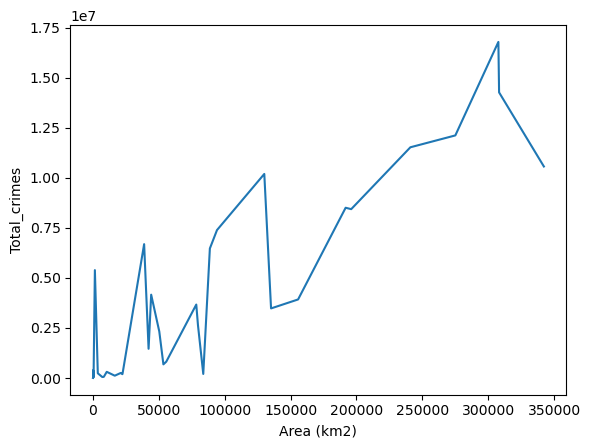

In [218]:
sns.lineplot(data=sawca,x='Area (km2)',y='Total_crimes')

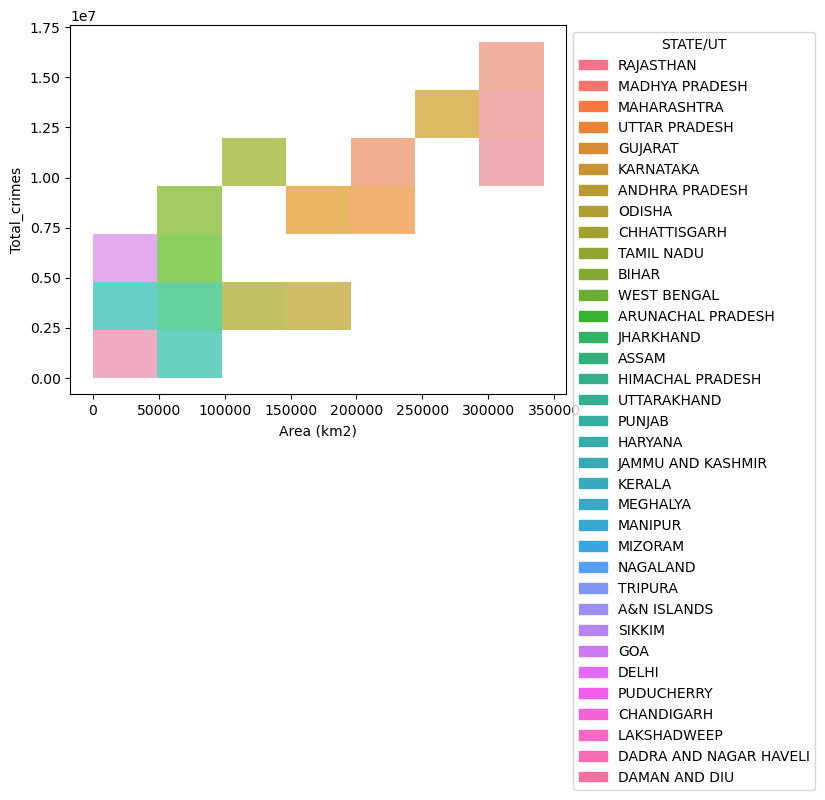

In [219]:
ax = sns.histplot(data=sawca,x='Area (km2)',y='Total_crimes',hue='STATE/UT')
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))
plt.show()

Above is the analysis of crimes wrt area

# 2.2	Analysis of the type of crime vs each state vs Literacy rate.

Following Data Preperation Step, continuing here 

In [220]:
dfs

[            STATE/UT       DISTRICT  YEAR  MURDER  ATTEMPT TO MURDER  \
 0     ANDHRA PRADESH       ADILABAD  2001     101                 60   
 1     ANDHRA PRADESH      ANANTAPUR  2001     151                125   
 2     ANDHRA PRADESH       CHITTOOR  2001     101                 57   
 3     ANDHRA PRADESH       CUDDAPAH  2001      80                 53   
 4     ANDHRA PRADESH  EAST GODAVARI  2001      82                 67   
 ...              ...            ...   ...     ...                ...   
 9012     LAKSHADWEEP    LAKSHADWEEP  2012       0                  0   
 9013     LAKSHADWEEP          TOTAL  2012       0                  0   
 9014      PUDUCHERRY       KARAIKAL  2012       5                  6   
 9015      PUDUCHERRY     PUDUCHERRY  2012      24                 21   
 9016      PUDUCHERRY          TOTAL  2012      29                 27   
 
       CULPABLE HOMICIDE NOT AMOUNTING TO MURDER  RAPE  CUSTODIAL RAPE  \
 0                                            17

In [221]:
list_cols(dfs)

01_District_wise_crimes_committed_IPC_2001_2012.csv
=+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+==+=
Index(['STATE/UT', 'DISTRICT', 'YEAR', 'MURDER', 'ATTEMPT TO MURDER',
       'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER', 'RAPE', 'CUSTODIAL RAPE',
       'OTHER RAPE', 'KIDNAPPING & ABDUCTION',
       'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
       'KIDNAPPING AND ABDUCTION OF OTHERS', 'DACOITY',
       'PREPARATION AND ASSEMBLY FOR DACOITY', 'ROBBERY', 'BURGLARY', 'THEFT',
       'AUTO THEFT', 'OTHER THEFT', 'RIOTS', 'CRIMINAL BREACH OF TRUST',
       'CHEATING', 'COUNTERFIETING', 'ARSON', 'HURT/GREVIOUS HURT',
       'DOWRY DEATHS', 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
       'INSULT TO MODESTY OF WOMEN', 'CRUELTY BY HUSBAND OR HIS RELATIVES',
       'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
       'CAUSING DEATH BY NEGLIGENCE', 'OTHER IPC CRIMES', 'TOTAL IPC CRIMES'],
      dtype='object')
02_01_District_wise_cri

In [222]:
ndf = []
for i in range(0,len(dfs)):
    if 'DISTRICT' in dfs[i].columns:
        df = dfs[i].groupby('STATE/UT').sum().reset_index()
        drp = ['DISTRICT','YEAR']
        if 'Total' in df.columns:
            drp.append('Total')
        elif 'TOTAL' in df.columns:
            drp.append('TOTAL')
        df.drop(columns=drp,inplace=True)
        ndf.append(df)
    else:
        ndf.append(df)

In [223]:
ndf

[             STATE/UT  MURDER  ATTEMPT TO MURDER  \
 0       A & N ISLANDS     320                130   
 1      ANDHRA PRADESH   63512              44840   
 2   ARUNACHAL PRADESH    1682                834   
 3               ASSAM   30864              11324   
 4               BIHAR   82490              81838   
 5          CHANDIGARH     486                602   
 6        CHHATTISGARH   24120              15820   
 7        D & N HAVELI     216                 62   
 8         DAMAN & DIU     136                 76   
 9               DELHI   12410              10554   
 10                GOA     974                538   
 11            GUJARAT   27550              12224   
 12            HARYANA   20942              14868   
 13   HIMACHAL PRADESH    2908               1670   
 14    JAMMU & KASHMIR   12608              20606   
 15          JHARKHAND   38120              24540   
 16          KARNATAKA   39874              37024   
 17             KERALA    9466              10

In [224]:
for df in ndf:
    print(len(df))

35
35
35
35
35
35
35
35


In [225]:
dlit = pd.read_excel('literacy.xlsx')

In [226]:
dlit.rename(columns={'State/UT':'STATE/UT'},inplace=True)

In [227]:
dlit['STATE/UT'] = dlit['STATE/UT'].str.upper()

In [228]:
dlit.replace({'A&N ISLANDS':'A & N ISLANDS',
            'DADRA AND NAGAR HAVELI':'D & N HAVELI',
            'DAMAN AND DIU':'DAMAN & DIU',
            'JAMMU AND KASHMIR':'JAMMU & KASHMIR',
            'MEGHALYA':'MEGHALAYA'},inplace=True)

In [229]:
[x for x in dlit['STATE/UT'].unique() if x not in ndf[0]['STATE/UT'].unique()]

[]

In [230]:
bigdf = dlit.set_index('STATE/UT')
bigdf.sort_index(inplace=True)

In [231]:
ndfs = []
for df in ndf:
    ndfs.append(df.set_index(['STATE/UT']))

In [232]:
for i,file in enumerate(files):
    df = ndfs[i]
    name = '_'.join(file.split('_')[-4:-2])
    cross_cols = [col for col in df.columns if col in bigdf.columns]
    cross_replace = {}
    for col in cross_cols:
        cross_replace[col] = f'{col}_{name}'
    df.rename(columns = cross_replace, inplace=True)
    bigdf = bigdf.join(df)
    

In [233]:
len(bigdf.columns)

103

In [234]:
[col for col in bigdf.columns if 'total' in str(col).lower()]

['TOTAL IPC CRIMES']

In [235]:
bigdf.drop(columns=['TOTAL IPC CRIMES'],inplace=True)

In [236]:
files

['01_District_wise_crimes_committed_IPC_2001_2012.csv',
 '02_01_District_wise_crimes_committed_against_SC_2001_2012.csv',
 '02_District_wise_crimes_committed_against_ST_2001_2012.csv',
 '03_District_wise_crimes_committed_against_children_2001_2012.csv',
 '08_01_Juvenile_apprehended_state_IPC_2001_2010.csv',
 '11_Property_stolen_and_recovered_nature_of_property_2001_2010.csv',
 '17_Crime_by_place_of_occurrence_2001_2012.csv',
 '42_District_wise_crimes_committed_against_women_2001_2012.csv']

In [237]:
'_'.join(files[0].split('_')[-4:-2])

'committed_IPC'

In [238]:
list(bigdf.columns)

[2001,
 2011,
 'MURDER',
 'ATTEMPT TO MURDER',
 'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER',
 'RAPE',
 'CUSTODIAL RAPE',
 'OTHER RAPE',
 'KIDNAPPING & ABDUCTION',
 'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
 'KIDNAPPING AND ABDUCTION OF OTHERS',
 'DACOITY',
 'PREPARATION AND ASSEMBLY FOR DACOITY',
 'ROBBERY',
 'BURGLARY',
 'THEFT',
 'AUTO THEFT',
 'OTHER THEFT',
 'RIOTS',
 'CRIMINAL BREACH OF TRUST',
 'CHEATING',
 'COUNTERFIETING',
 'ARSON',
 'HURT/GREVIOUS HURT',
 'DOWRY DEATHS',
 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
 'INSULT TO MODESTY OF WOMEN',
 'CRUELTY BY HUSBAND OR HIS RELATIVES',
 'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
 'CAUSING DEATH BY NEGLIGENCE',
 'OTHER IPC CRIMES',
 'Murder',
 'Rape',
 'Kidnapping and Abduction',
 'Dacoity',
 'Robbery',
 'Arson',
 'Hurt',
 'Prevention of atrocities (POA) Act',
 'Protection of Civil Rights (PCR) Act',
 'Other Crimes Against SCs',
 'Murder_against_ST',
 'Rape_against_ST',
 'Kidnapping Abduction',
 'Dacoity_agai

In [239]:
bigdf['AVG_LITERACY_RATE'] = (bigdf[2001]+bigdf[2011])/2

In [240]:
bigdf.drop(columns=[2001,2011],inplace=True)

In [241]:
list(bigdf.columns)

['MURDER',
 'ATTEMPT TO MURDER',
 'CULPABLE HOMICIDE NOT AMOUNTING TO MURDER',
 'RAPE',
 'CUSTODIAL RAPE',
 'OTHER RAPE',
 'KIDNAPPING & ABDUCTION',
 'KIDNAPPING AND ABDUCTION OF WOMEN AND GIRLS',
 'KIDNAPPING AND ABDUCTION OF OTHERS',
 'DACOITY',
 'PREPARATION AND ASSEMBLY FOR DACOITY',
 'ROBBERY',
 'BURGLARY',
 'THEFT',
 'AUTO THEFT',
 'OTHER THEFT',
 'RIOTS',
 'CRIMINAL BREACH OF TRUST',
 'CHEATING',
 'COUNTERFIETING',
 'ARSON',
 'HURT/GREVIOUS HURT',
 'DOWRY DEATHS',
 'ASSAULT ON WOMEN WITH INTENT TO OUTRAGE HER MODESTY',
 'INSULT TO MODESTY OF WOMEN',
 'CRUELTY BY HUSBAND OR HIS RELATIVES',
 'IMPORTATION OF GIRLS FROM FOREIGN COUNTRIES',
 'CAUSING DEATH BY NEGLIGENCE',
 'OTHER IPC CRIMES',
 'Murder',
 'Rape',
 'Kidnapping and Abduction',
 'Dacoity',
 'Robbery',
 'Arson',
 'Hurt',
 'Prevention of atrocities (POA) Act',
 'Protection of Civil Rights (PCR) Act',
 'Other Crimes Against SCs',
 'Murder_against_ST',
 'Rape_against_ST',
 'Kidnapping Abduction',
 'Dacoity_against_ST',
 'Rob

In [242]:
color_palette = sns.color_palette('bright')

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\2851000032.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1)


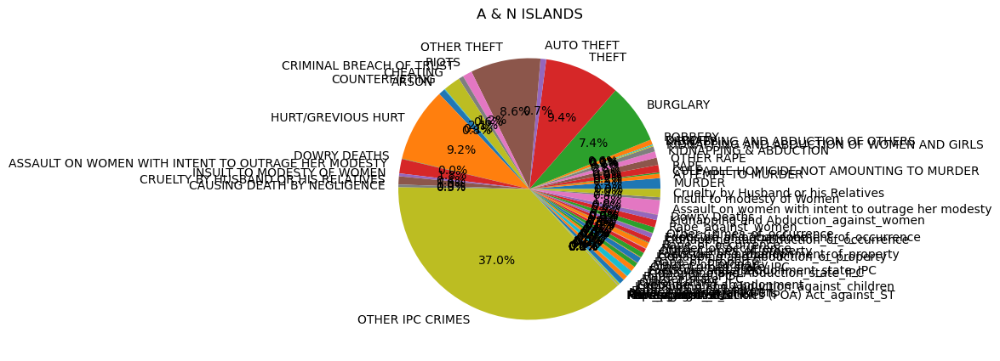

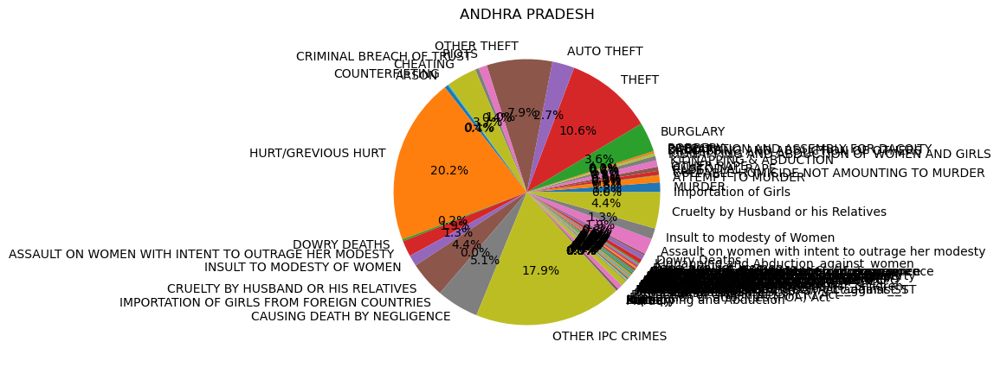

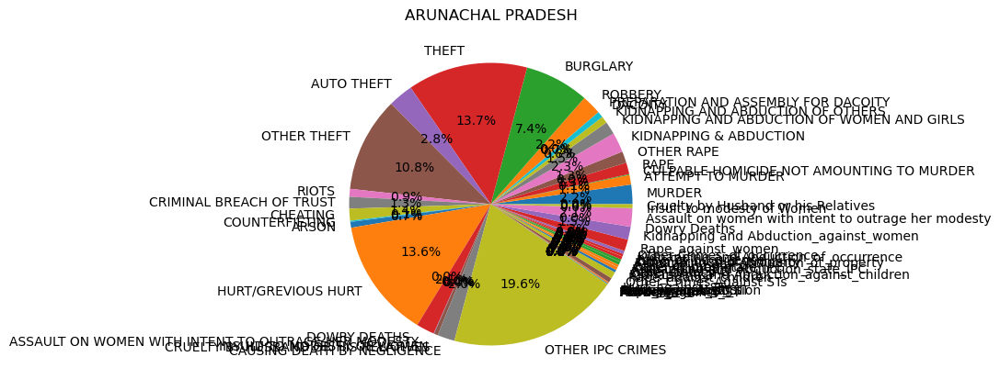

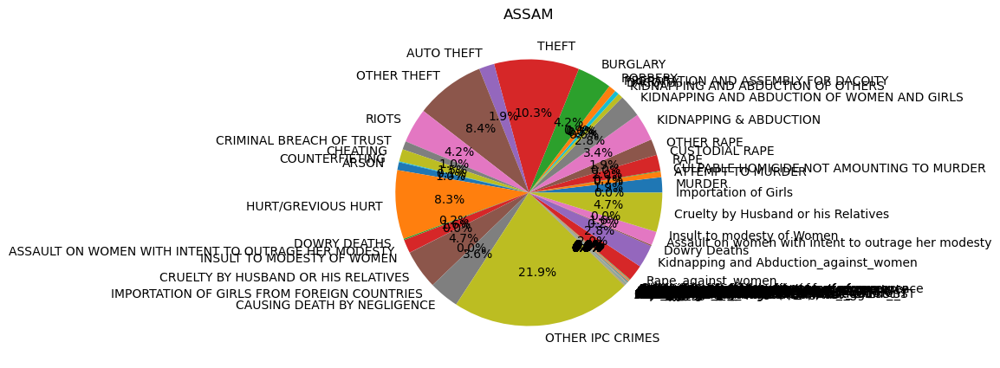

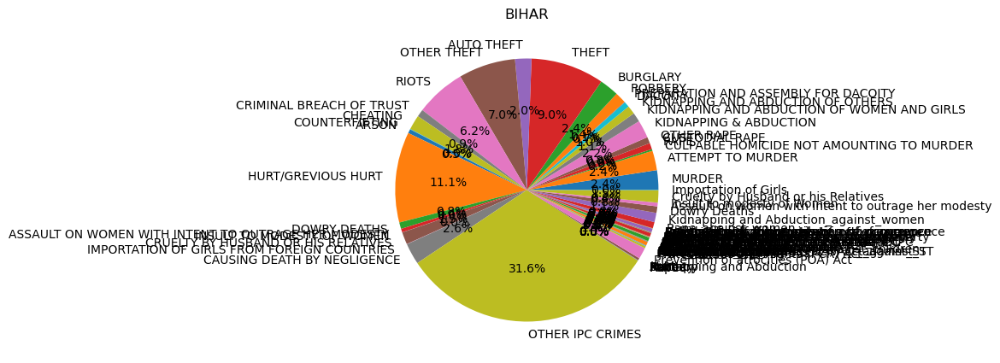

...

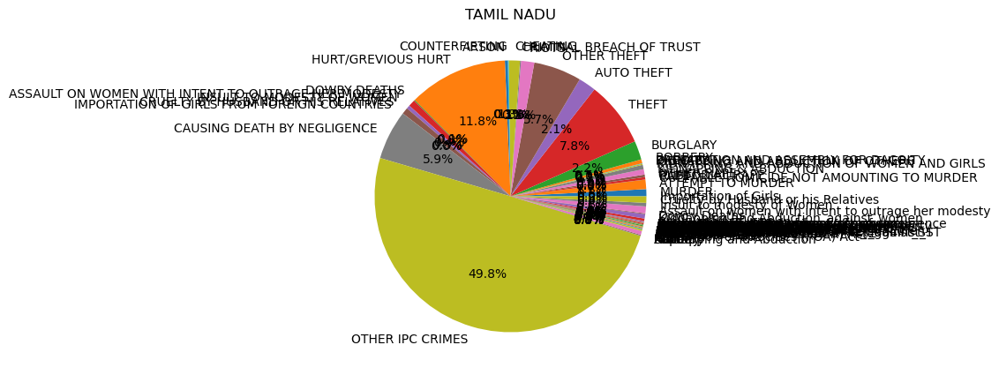

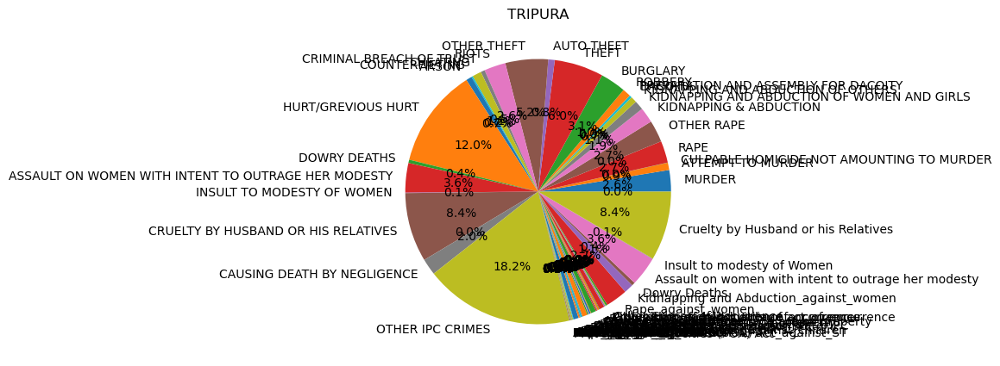

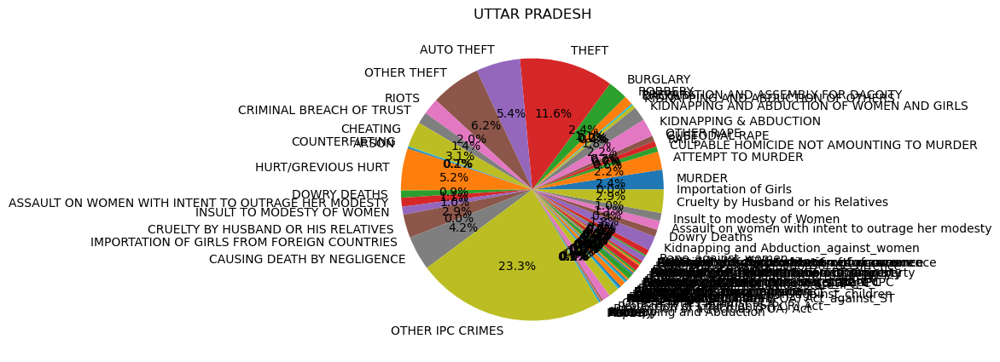

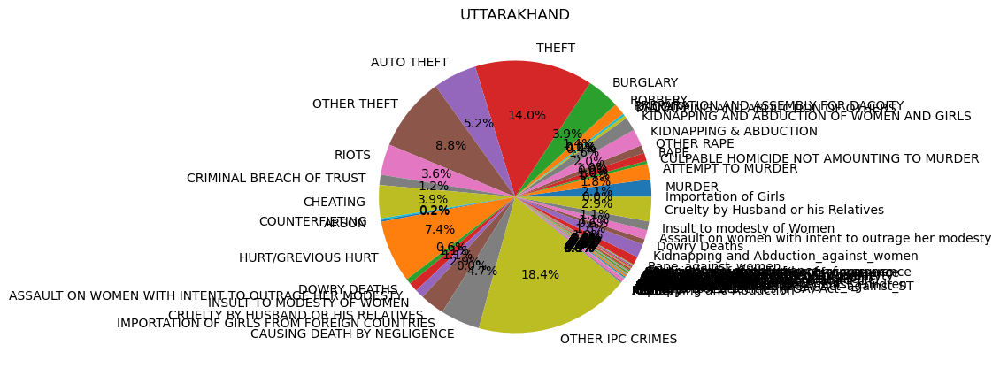

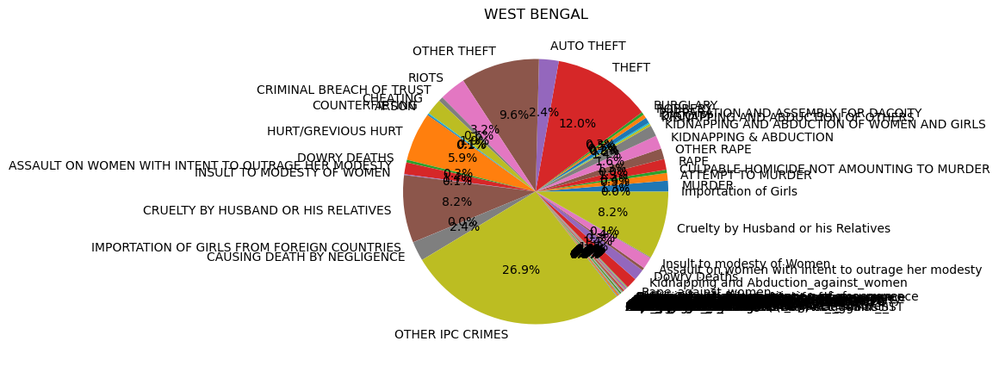

In [243]:
big_df_drop = bigdf.reset_index(inplace=False).drop(columns=['STATE/UT','AVG_LITERACY_RATE'])
for ind in bigdf.reset_index().index:
   fig, ax = plt.subplots(1,1)
   fig.set_size_inches(5,5)
   big_df_drop.iloc[ind].plot(kind='pie', ax=ax, autopct='%1.1f%%')
   ax.set_ylabel('')
   ax.set_xlabel('')
   ax.set_title(bigdf.reset_index().loc[ind,'STATE/UT'])

We can see the proportions of crimes wrt state. Other IPC crimes are more in almost all the states. Let's remove that column and see what seems most per state

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\200363968.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1)


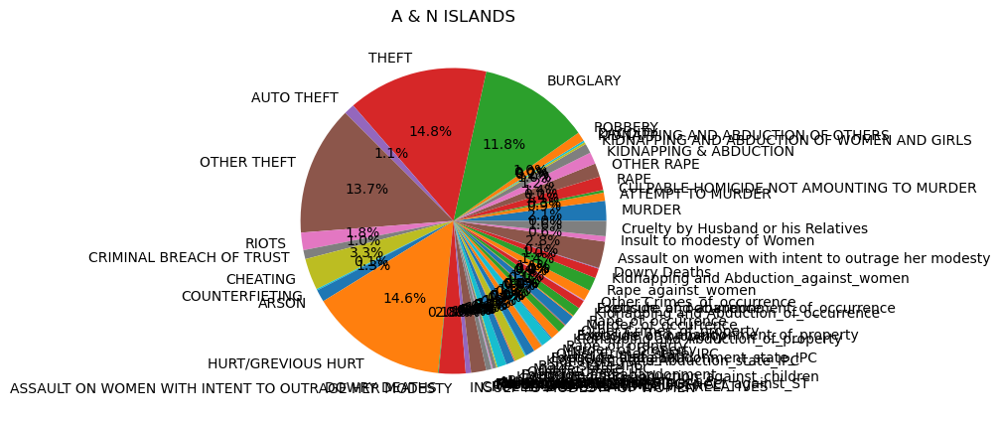

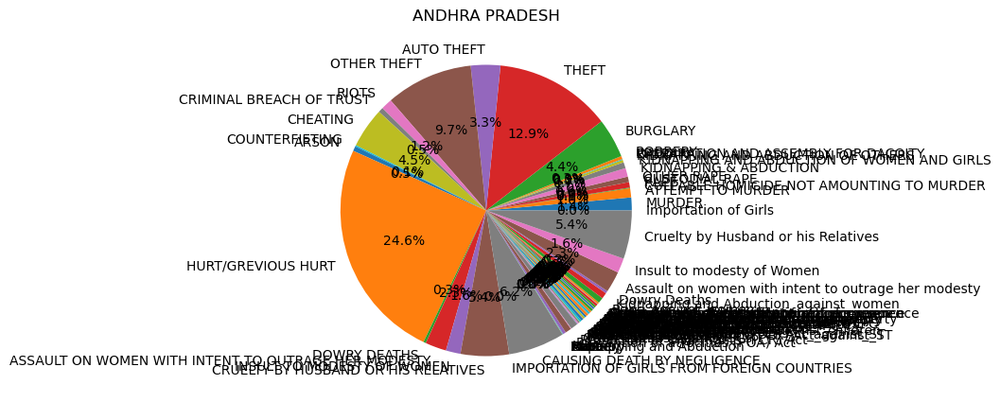

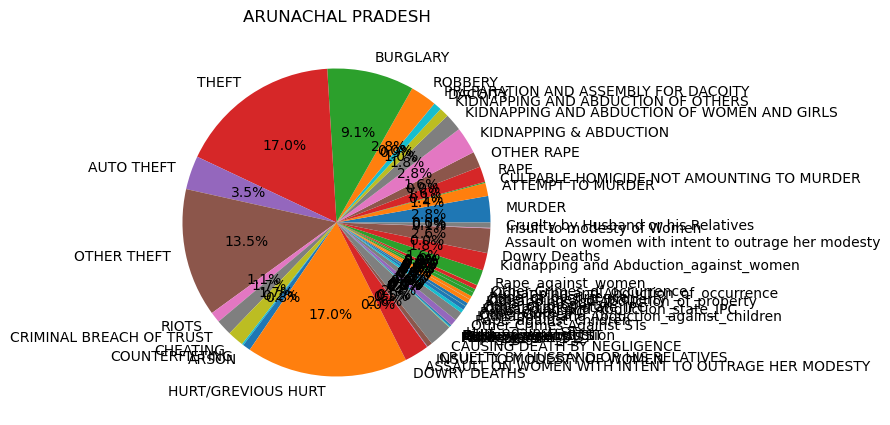

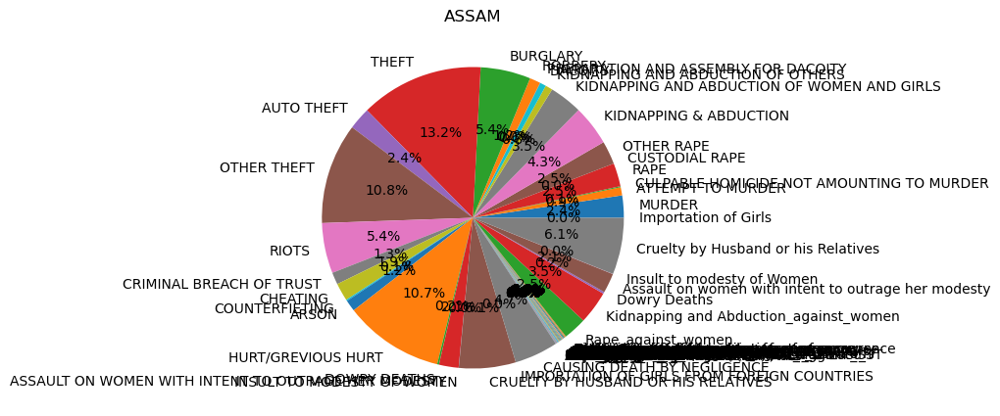

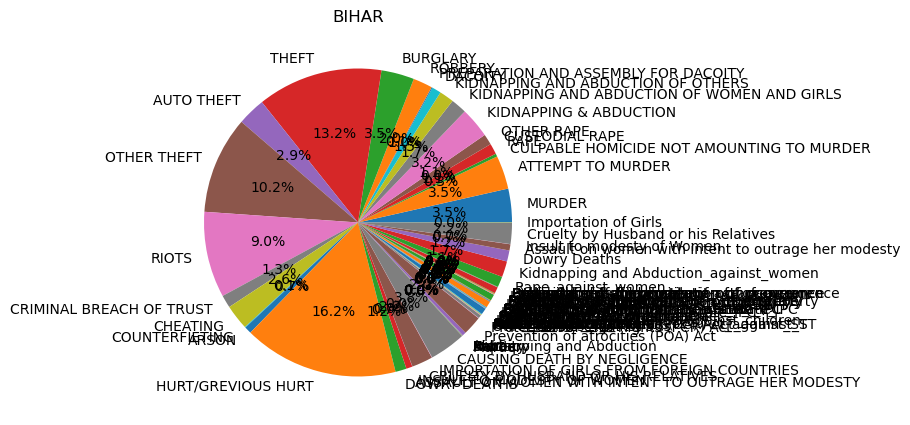

...

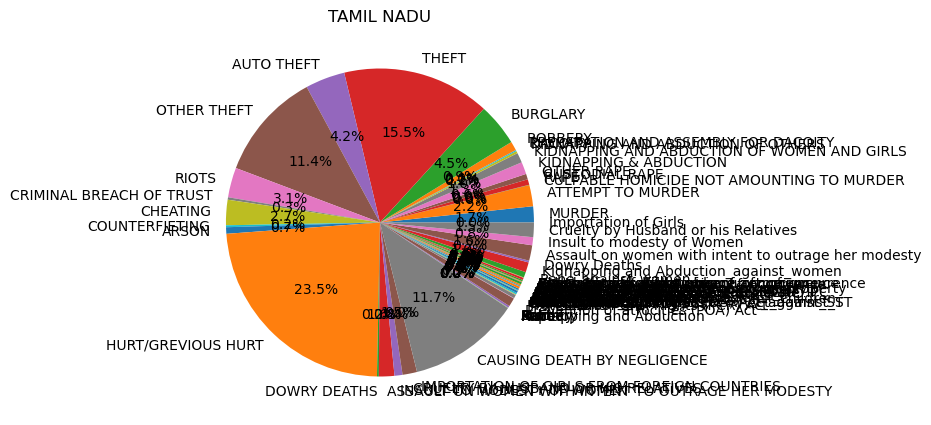

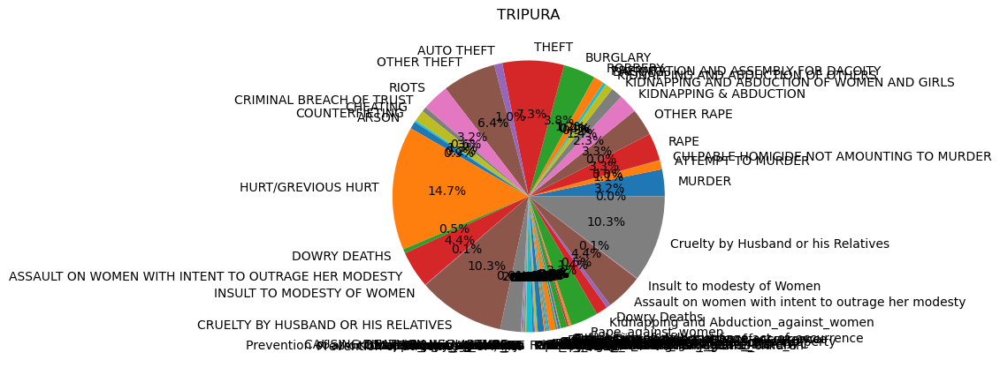

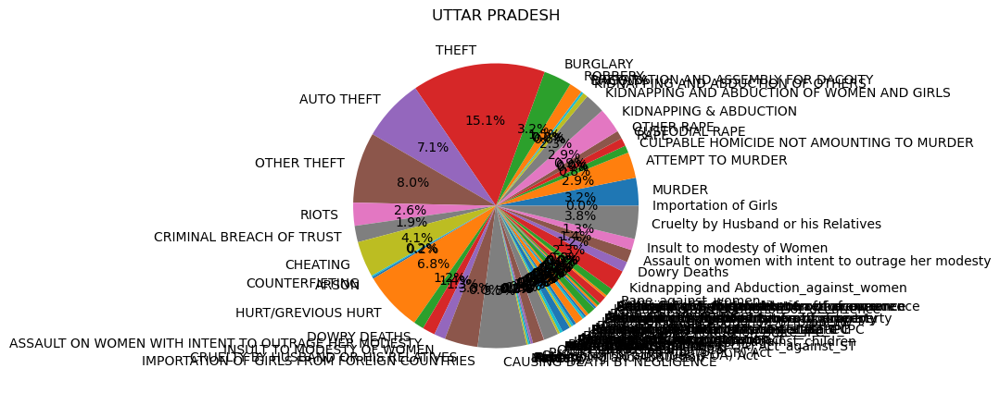

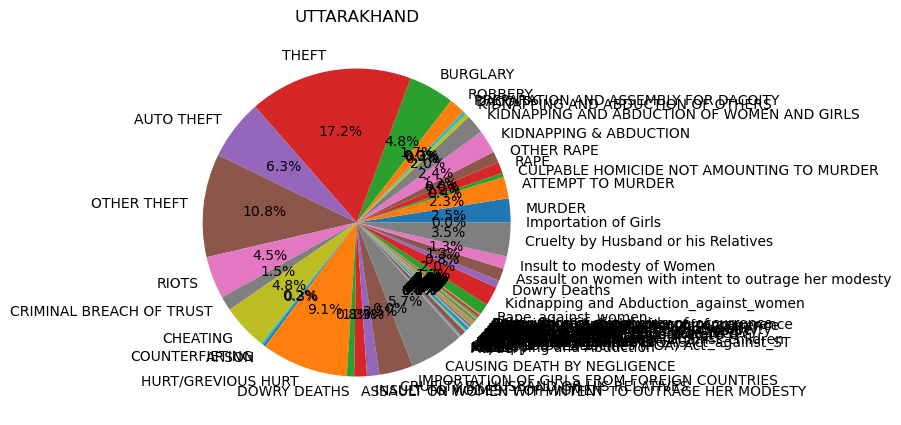

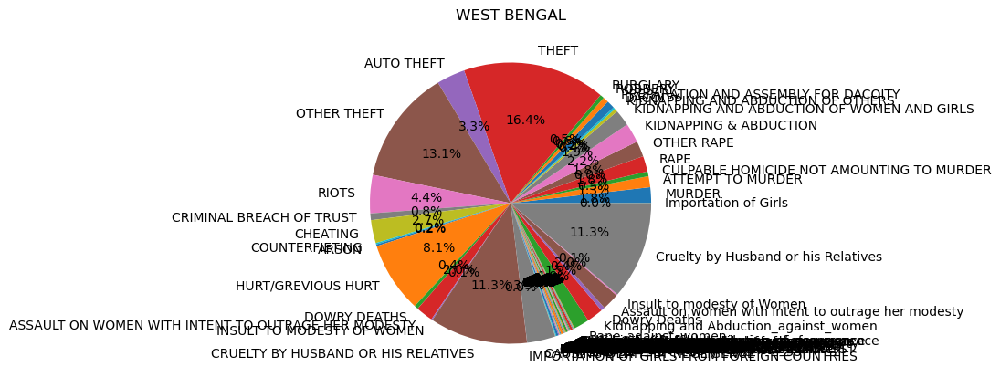

In [244]:
big_df_drop = bigdf.reset_index(inplace=False).drop(columns=['STATE/UT','AVG_LITERACY_RATE','OTHER IPC CRIMES'])
for ind in bigdf.reset_index().index:
   fig, ax = plt.subplots(1,1)
   fig.set_size_inches(5,5)
   big_df_drop.iloc[ind].plot(kind='pie', ax=ax, autopct='%1.1f%%')
   ax.set_ylabel('')
   ax.set_xlabel('')
   ax.set_title(bigdf.reset_index().loc[ind,'STATE/UT'])

We can see Thefts of different kinds have occupied significant portion on the pie charts. After thefts, hurt/Grevious hurt took most of the incidents. Let's remove theft kinds and see

C:\Users\LEELA DURGA PRASAD\AppData\Local\Temp\ipykernel_1244\1422997930.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(1,1)


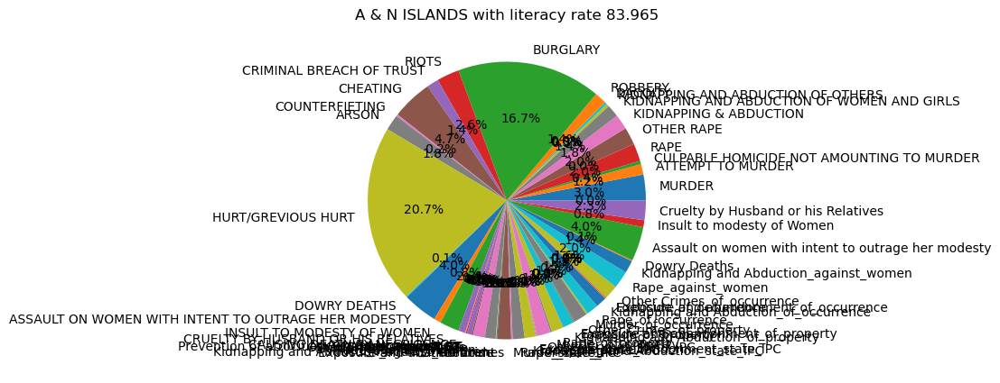

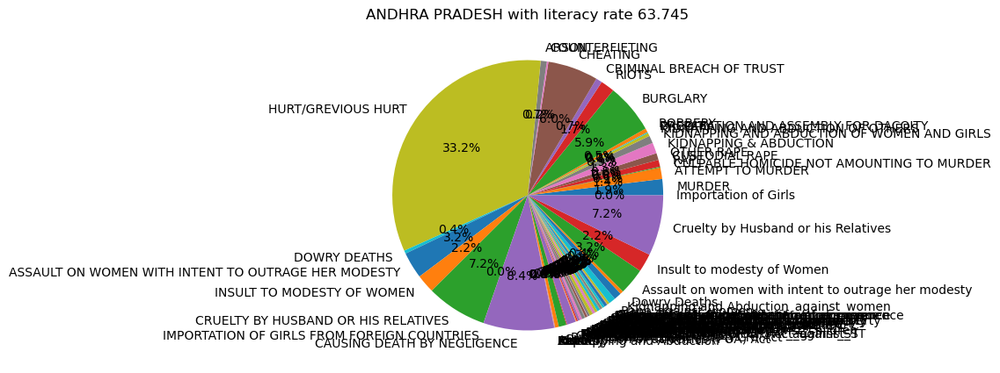

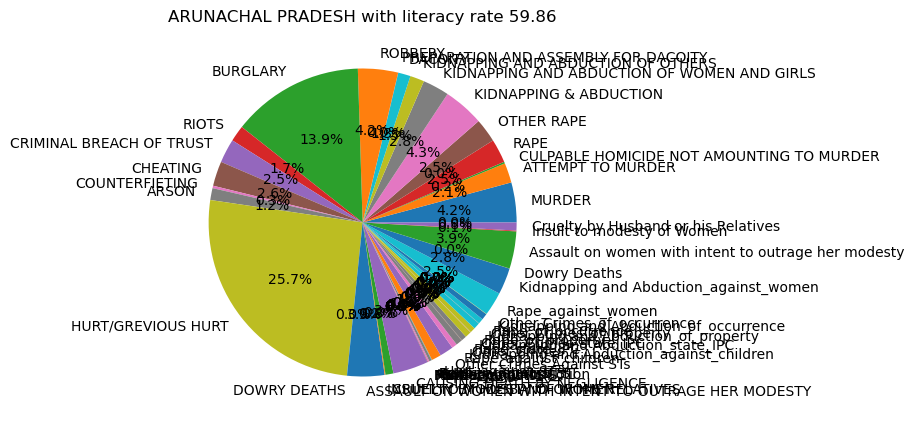

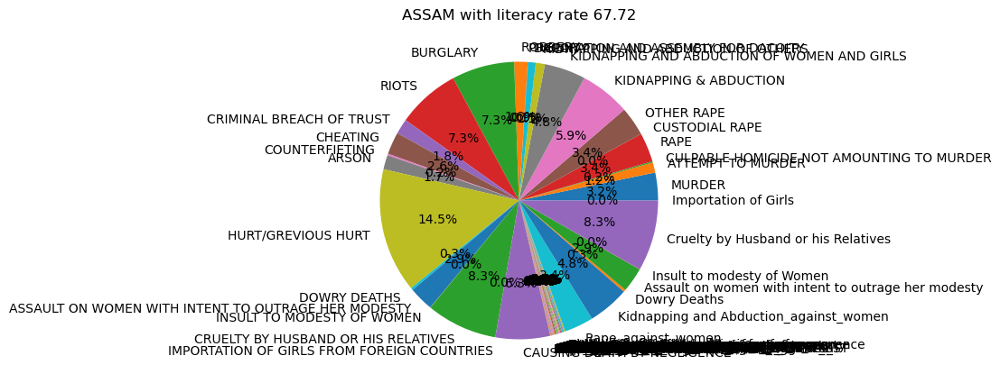

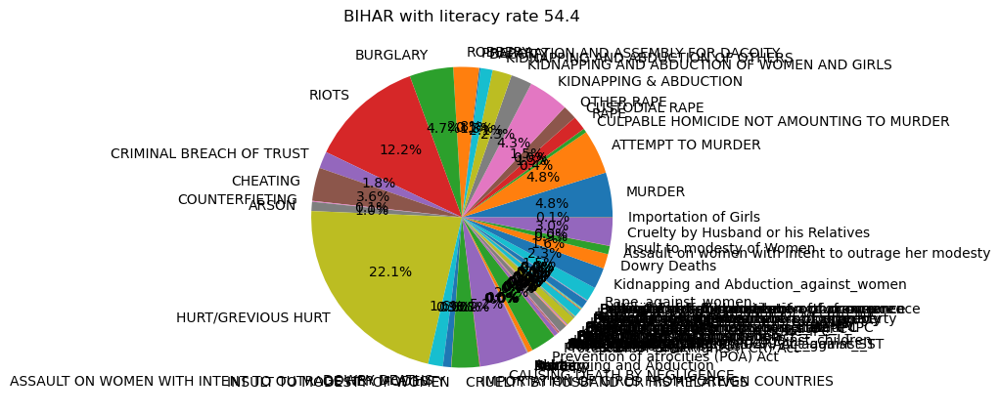

...

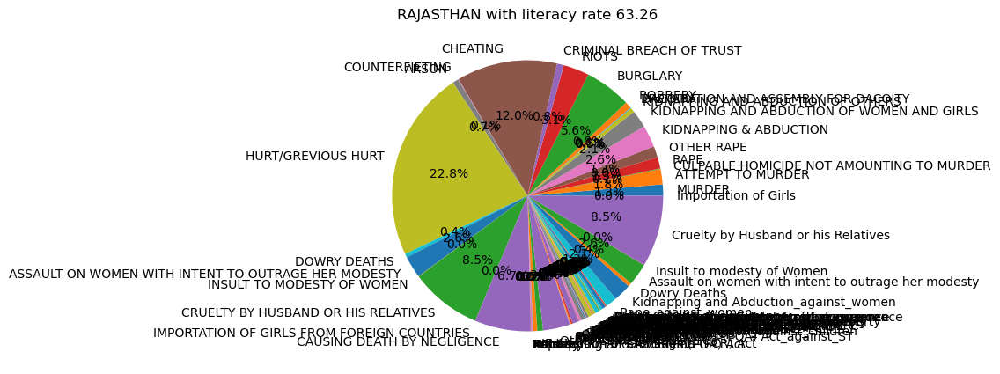

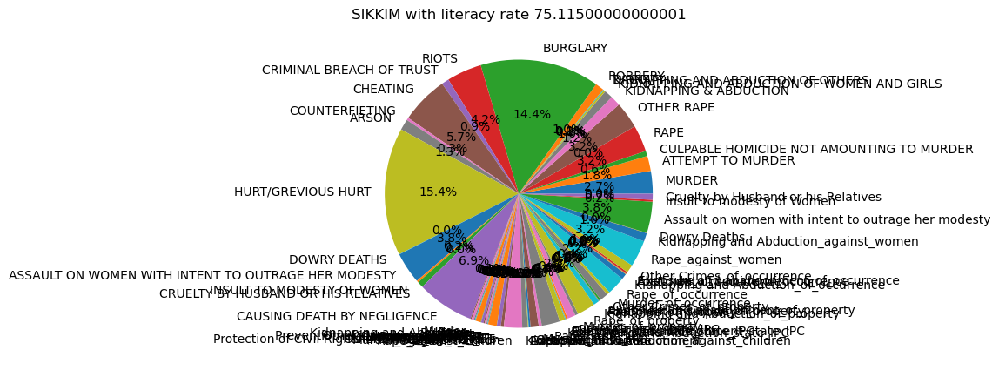

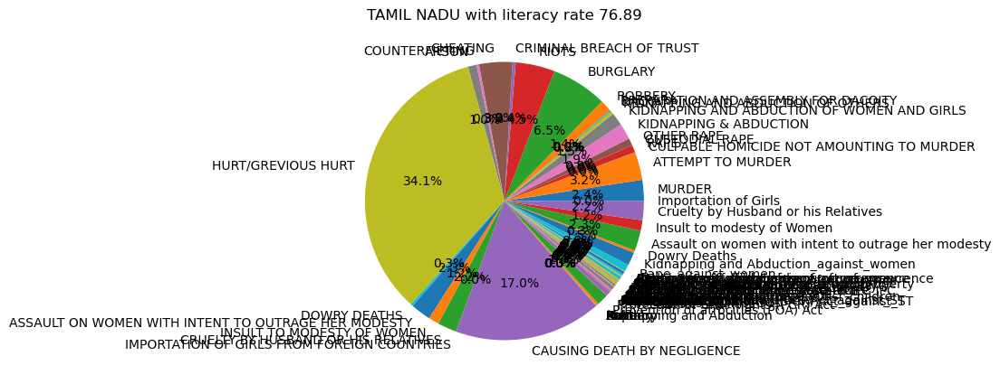

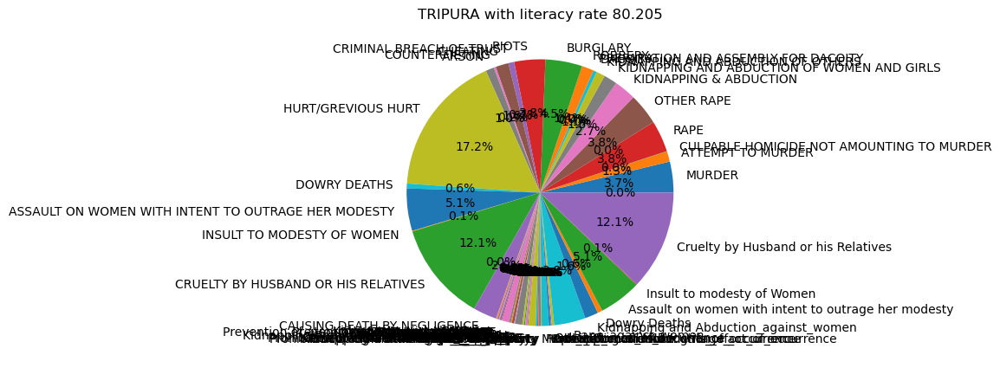

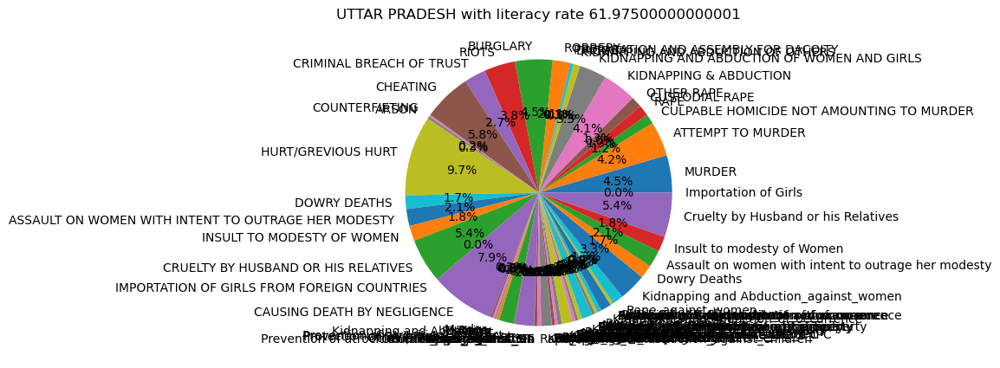

In [ ]:
big_df_drop = bigdf.reset_index(inplace=False).drop(columns=['STATE/UT','OTHER IPC CRIMES','AVG_LITERACY_RATE','THEFT','AUTO THEFT','OTHER THEFT'])
for ind in bigdf.reset_index().index:
   fig, ax = plt.subplots(1,1)
   fig.set_size_inches(5,5)
   big_df_drop.iloc[ind].plot(kind='pie', ax=ax, autopct='%1.1f%%')
   ax.set_ylabel('')
   ax.set_xlabel('')
   title_ = bigdf.reset_index().loc[ind,'STATE/UT'] + ' with literacy rate ' + str(bigdf.reset_index().loc[ind,'AVG_LITERACY_RATE'])
   ax.set_title(title_)

In [ ]:
bigdf['STATE/UT']

#                                                Crime Report

Upon careful analysis, here is the detailed report on crime rates in India, analysed state wise

>>> With increase in Area, we can see there is increase in violance and crime
<br><br><br>
1. Andaman & Nicobar Islands:
    > In A&N islands, we can see that with increase of literacy rate, there is a sharp increase in crime rate.
    <br> Over the years, there is increase in crime rate until 2010, after 2011 there is a sharp decrease.

2. Andhra Pradesh:
    > In Andhra Pradesh we can see that there is a sharp increase in crime rate with increase in literacy rate
    <br> Over the years, there is increase in crime rate until 2010, after 2011 there is a sharp decrease.

3. Arunachal Pradesh:
    > In Arunachal Pradesh we can see that there is a sharp increase in crime rate with increase in literacy rate
    <br> Over the years, there is fluxuation in crime rate until 2010, after 2011 there is a sharp decrease.

4. Assam:
    > In Assam we can see that there is a sharp increase in crime rate with increase in literacy rate
    <br> Over the years, there is increase in crime rate until 2010, after 2011 there is a slight decrease.

5. Bihar:
    > Bihar tends to have an overall increasing crime rate with respect to increase in literacy rate
    <br> Over the years, there is increase in crime rate until 2010, after 2011 there is a sharp decrease.

6. Chandighar:
    > In Chandighar we can see that there is a sharp decrease in crime rate with increase in literacy rate till 85 and then there is 
      a great increase in crimes till 108 and then we see a sharp decrease till 115. This says that we have less crime rate when       
      literacy is around 90.
    <br> Till 2004, there is a decrease, after 2006 there is a spike in crime rate, after which it took downtrend

7. Chahattisgarh:
    > In Chahattisghar we can see that there is a increase in crime rate with increase in literacy rate with no declining significantly
    <br> Over the years, there is increase in crime rate until 2009, after 2010 there is a sharp decrease.
  

8. Dadra and Nagar Haveli:
    > In Dadra and Nagar Havali we can see that there is a increase in crime rate with increase in literacy rate with a slight fall after 190 declining significantly
    <br> Over the years, there is increase in crime rate until 2009, after 2011 there is a sharp decrease.
  

9. Daman and Diu:
    > In Daman and Diu we can see that there is a zig zag curve which shows that crime is irrespective of literacy mostly but after 135 we can see a drastic drop which
    <br> Over the years, there is are spikes and downs in the trend until 2008 where it took complete downtrend

10. Delhi:
    > In Delhi we can see that there is a increase in crime rate with increase in literacy rate with no declining
    <br> In downtrend till 2003, uptrend till 2010 and sudden drop in crime after 2010
  

11. Goa:
    > In Goa we can see that there is a increase in crime rate with increase in literacy rate with no declining
    <br> Very low till 2006 and started and uptrend until 2010 after which there is a downtrend
  

12. Gujarat:
    > In Gujarat can see that there is a increase in crime rate with increase in literacy rate but with a decline after 125
    <br> Uptrend till 2008 and decline to very low point after 2008
  

13. Haryana:
    > In Haryana we can see that there is a increase in crime rate with increase in literacy rate with no declining significantly
    <br> low till 2004, started uptrend and maintained peak till 2010 and sharp decline
  

14. Himachal Pradesh:
    > In Himachal Pradesh we can see that there is a increase in crime rate with increase in literacy rate with a decline after 115 significantly
    <br> Uptrend till 2008 and started it's downtrend from there.
  

15. Jammu and Kashmir:
    > In Jammu and Kashmir we can see that there is a increase in crime rate with increase in literacy rate with no declining
    <br> Zig zag uptrend till 2010 and sudden decline in crimes
  

16. Jharkhand:
    > In Jharkhand we can see that there is a increase in crime rate with increase in literacy rate with no declining significantly
    <br> Complete uptrend till 2010 and sharp decline in 2011
  

17. Karnataka:
    > In Karnataka we can see that there is a increase in crime rate with increase in literacy rate with no declining significantly
    <br> Complete uptrend till 2010 and sharp decline in 2011
  

18. Kerala:
    > In Kerala we can see that there is a increase in crime rate with increase in literacy rate, though there is a drop at 95 it gradually went upwards
    <br> No downtrend, continuosly increasing with years
  

19. Lakshadweep:
    > In Lakshadweep we can see that there is a increase in crime rate with increase in literacy rate with a sharp decline after 125
    <br> Gradual increase till 2009 and sudden sharp decrease
  

20. Madhya pradesh:
    > In Madhya pradesh we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> Uptrend till 2010 and sharp decline in 2011
  

21. Maharastra:
    > In Maharastra we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> Uptrend till 2010 and sharp decline in 2011
  

22. Manipur:
    > In Manipur we can see that there is a increase in crime rate with increase in literacy rate with a sharp decline after 115
    <br> Uptrend till 2008 and decline till 2010 and incline in 2011

23. Meghalaya:
    > In Meghalaya we can see that there is a increase in crime rate with increase in literacy rate with no declining
    <br> Uptrend till 2008 and sharp decline in 2011
  

24. Mizoram:
    > In Mizoram we can see that with increase in literacy there is control in total crimes
    <br> Uptrend till 2003 and there is sharp and gradual decline till 2011. Low crime with passing years
  

25. Nagaland:
    > In Nagaland we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> Decline till 2004, from 2004 to 2010 gradual incline and sharp decline in 2011
  

26. Odisha:
    > In Odisha we can see that there is a increase in crime rate with increase in literacy rate with no declining
    <br> Uptrend till 2010 and sharp decline in 2011
  

27. 25. Pondicherry:
    > In Pondicherry we can see that there is a increase in crime rate with increase in literacy rate with a sharp decline after 105
    <br> Uptrend till 2007 and sharp decline till 2011
  

28. Punjab:
    > In Punjab we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> In control till 2004, Uptrend till 2010 and sharp decline in 2011
  

29. Rajasthan:
    > In Rajasthan we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> In control till 2005, Uptrend till 2010 and sharp decline in 2011
  

30. Sikkim:
    > In Sikkim we can see that there is a increase in crime rate with increase in literacy rate with a sharp decline after 150
    <br> Uptrend till 2008 and sharp decline till 2011
  

31. Tamilnadu:
    > In Tamilnadu we can see that there is a decrease in crime rate with increase in literacy rate till 105 after that it skyrocketed
    <br> Downtrend till 2006, Uptrend till 2010 and sharp decline in 2011
  

32. Tripura:
    > In tripura we can see that there is a increase in crime rate with increase in literacy rate with no decline
    <br> Uptrend till 2010 and sharp decline in 2011
    
  

33. Uttar Pradesh:
    > In UP we can see that there is a decreaes in crime rate with increase in literacy rate till 70 later which it increased gradually with no decline
    <br> Sharp decline till 2003, took gradual uptrend
  

34. Uttarakhand:
    > In Uttarakhand we can see that there is a increase in crime rate with increase in literacy rate. It follows a uptrend
    <br> Uptrend till 2010 and sharp decline in 2011
  

35. West Bengal:
    > In West Bengal we can see that there is a increase in crime rate with increase in literacy rate with no decline at all
    <br> Uptrend till 2010 with no much decline
  

